# Task description:
## Efficient supply allocation

The success of any taxi provider depends on a marketplace or efficient matching supply and demand in real-time. There are two sides in a ride-hailing marketplace: riders (demand) and drivers (supply). One of the challenges that we aim to solve is efficient supply allocation, so riders can always get a ride and drivers have stable earnings. Knowledge about how demand changes over time and space is crucial to comprehend supply dynamics. 

## We will evaluate:

* The quality of your exploratory data analysis
* The coherence and structure of your ideas and code
* Your modeling approach, training, and validation methodology
* The applicability of your modeling technique to the real-life task you are trying to solve
* Your take on how the impact of the model should be evaluated in real-world interactions with our user base 

## Tasks:
1. Explore the data and suggest a solution to guide the drivers towards areas with higher expected demand at given time and location
2. Build and document a baseline model for your solution
3. Describe how you would design and deploy such a model
4. Describe how to communicate model recommendations to drivers
5. Think through and describe the design of the experiment  that would validate your solution for live operations taking into account marketplace specifics

## Dataset description:

The source data is approximately 630000 rows of synthetic ride demand data which resembles the real-life situation in the city of Tallinn:

* ``start_time`` - time when the order was made
* ``start_lat`` - latitude of the order's pick-up point
* ``start_lng`` - longitude of the order's pick-up point
* ``end_lat`` - latitude of the order's destination point
* ``end_lng`` - longitude of the order's destination point
* ``ride_value`` - how much monetary value is in this particular ride

# Step 1: Libraries import and first data overview

In [1]:
# general libraries
import pandas as pd
import numpy as np
from numpy.random import RandomState
import time
import holidays
from datetime import datetime

# visualization libraries
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import plotly.io as pio
pio.renderers.default = "svg"

# Weather and location libraries
from meteostat import Point, Hourly
import reverse_geocoder as rg
import gpxpy.geo

# ML and clustering libraries
from statsmodels.tsa.stattools import adfuller
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor, HistGradientBoostingRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.impute import SimpleImputer
from xgboost import XGBRegressor
from keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Input
from sklearn.preprocessing import MinMaxScaler


pd.__version__

'2.0.3'

In [2]:
try:
    df = pd.read_csv("robotex5.csv")
except:
    print("Something went wrong!")


df_length_unmodified = len(df)

df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value
0,2022-03-06 15:02:39.329452000,59.407910,24.689836,59.513027,24.831630,3.51825
1,2022-03-10 11:15:55.177526000,59.441650,24.762712,59.426450,24.783076,0.50750
2,2022-03-06 14:23:33.893257000,59.435404,24.749795,59.431901,24.761588,0.19025
3,2022-03-03 09:11:59.104192000,59.406920,24.659006,59.381093,24.641652,0.75600
4,2022-03-06 00:13:01.290346000,59.434940,24.753641,59.489203,24.876170,2.27100


#### General info about the dataset:

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 627210 entries, 0 to 627209
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   start_time  627210 non-null  object 
 1   start_lat   627210 non-null  float64
 2   start_lng   627210 non-null  float64
 3   end_lat     627210 non-null  float64
 4   end_lng     627210 non-null  float64
 5   ride_value  627210 non-null  float64
dtypes: float64(5), object(1)
memory usage: 28.7+ MB


#### Checking for the nan values in the dataset:

In [4]:
df.isna().sum()

start_time    0
start_lat     0
start_lng     0
end_lat       0
end_lng       0
ride_value    0
dtype: int64

#### Let's look at the histograms of the columns in the dataset:

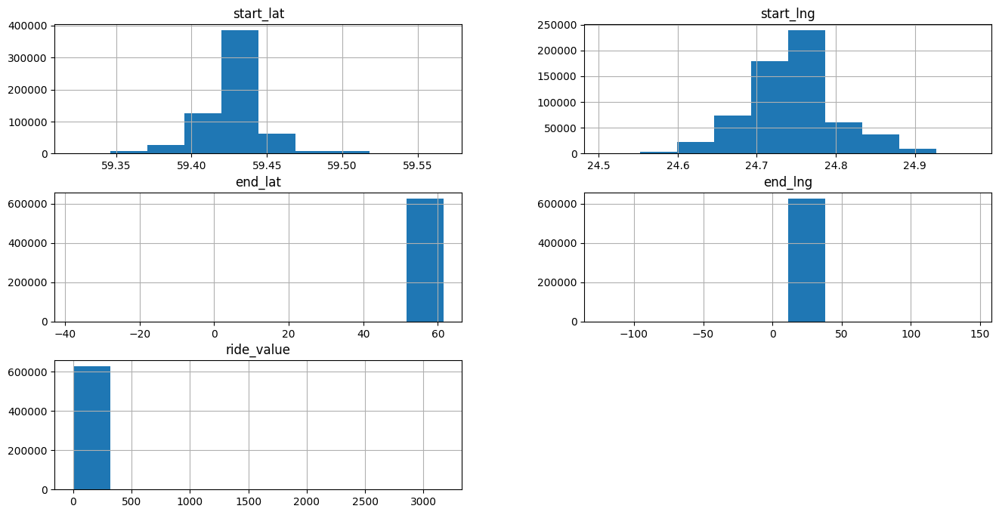

In [5]:
df.hist(figsize=(16, 8));

#### Generate descriptive statistics for the dataset:

In [6]:
df.describe()

,start_lat,start_lng,end_lat,end_lng,ride_value
count,627210.000000,627210.000000,627210.000000,627210.000000,627210.000000
mean,59.428682,24.743468,59.397797,24.724847,2.261384
std,0.021764,0.056872,1.392755,1.650709,44.889892
min,59.321557,24.505199,-37.819979,-122.453962,0.107628
25%,59.418803,24.713140,59.415215,24.707919,0.545250
50%,59.432069,24.744674,59.430697,24.744335,1.059000
75%,59.439024,24.768115,59.439262,24.773924,1.712000
max,59.566998,24.973743,61.552744,144.966110,3172.701000


## Intermediate conclusion
1. The data has no nan values which is good.
2. Columns have meaningful names and are written correctly and in lower case. 
3. The ``start_time`` column dtype should be converted to datetime. The dataset is not sorted by the ``start_time`` column.
4. All the other float64 columns can be converted to the smaller bit data-type without losing any significant info.
5. Columns ``start_lat`` and ``start_lng`` look fine. The starting latitude and longitude distributions are close to normal and look realistic. There are no significant outliers. That mean that they all roughly start somewhere in the area of Tallin (59.4370° N, 24.7536° E).
6. We can observe that the columns ``end_lat`` and ``end_long`` apparently have a lot of outliers of unknown nature. Most of the rides end somewhere in the area of Tallin. However, some outliers imply that people take a cab in Tallin and travel with it to either somewhere in the middle of South Pacific Ocean or somewhere to the Pacific ocean between Australia and New Zealand. Since the dataset represents the taxi demand in the city of Tallin, we can easily delete these outliers.
7. The same applies to the ``ride_value`` column. We can see that its median (50% percentile), that is not affected by outliers, equals to 1.059. Hence, the outlier values like 3172.7 probably represent trips from Tallin to Southwest Pacific Ocean :) and can be ignored for our research.

# Step 2: data preprocessing

## 2.1 Object to datetime

We will cut out nanoseconds since they are too excesive for our purpose. Regular seconds will be enough.

In [7]:
df.start_time = pd.to_datetime(df.start_time).astype('datetime64[s]')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 627210 entries, 0 to 627209
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype        
---  ------      --------------   -----        
 0   start_time  627210 non-null  datetime64[s]
 1   start_lat   627210 non-null  float64      
 2   start_lng   627210 non-null  float64      
 3   end_lat     627210 non-null  float64      
 4   end_lng     627210 non-null  float64      
 5   ride_value  627210 non-null  float64      
dtypes: datetime64[s](1), float64(5)
memory usage: 28.7 MB


In [8]:
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value
0,2022-03-06 15:02:39,59.407910,24.689836,59.513027,24.831630,3.51825
1,2022-03-10 11:15:55,59.441650,24.762712,59.426450,24.783076,0.50750
2,2022-03-06 14:23:33,59.435404,24.749795,59.431901,24.761588,0.19025
3,2022-03-03 09:11:59,59.406920,24.659006,59.381093,24.641652,0.75600
4,2022-03-06 00:13:01,59.434940,24.753641,59.489203,24.876170,2.27100


In [9]:
df = df.sort_values('start_time').reset_index(drop='index')
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value
0,2022-03-01 00:00:07,59.438142,24.728677,59.553133,24.802705,3.35200
1,2022-03-01 00:00:17,59.443230,24.753330,59.391667,24.722047,1.49500
2,2022-03-01 00:00:20,59.431849,24.768252,59.433692,24.728579,0.55275
3,2022-03-01 00:00:20,59.439587,24.748874,59.452895,24.871234,1.73725
4,2022-03-01 00:00:25,59.367751,24.645455,59.396104,24.800205,2.28675


That was easy!

## 2.2 Dtype conversion

The [wiki.openstreetmap](https://wiki.openstreetmap.org/wiki/Precision_of_coordinates) tells the following: 

``Just because a coordinate has many decimal places does not mean that it is an accurate measurement.
If a device produces a measured coordinate with 8 decimal places, this would suggest that it has an accuracy of 1 centimetre. A precision of about one metre is achieved with 5 decimal points (##.#####°).``

Lets convert the float64 columns to float32. This will save us a lot of memory (especially in a case of really big datasets) and increase our computing time. This both will result in cost savings for our company.
But first, lets show the difference between float16, float32, and float64 values. Spoiler: in most cases we do not need such a high precision as float64 provides us.

We can see from the code below, that the float32 dtype provide us with up to 9 digits after the coma precision. Let's stick to a 6-digit precision (1-metre positional accuracy) that is more than enough for our purpose . On the other side, using float16 will corrupt some of our data, reducing the accuracy to around 11 metres.

In [10]:
number = 0.123456789101112131415

a = np.array([number], dtype=np.float16)
print("16bit: ", a[0])

a = np.array([number], dtype=np.float32)
print("32bit: ", a[0])

a = np.array([number], dtype=np.float64)
print("64bit: ", a[0])

16bit:  0.1235
32bit:  0.12345679
64bit:  0.12345678910111213


In [11]:
columns = ['start_lat', 'start_lng', 'end_lat', 'end_lng', 'ride_value']
for col in columns:
    df[col] = df[col].astype('float32')

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 627210 entries, 0 to 627209
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype        
---  ------      --------------   -----        
 0   start_time  627210 non-null  datetime64[s]
 1   start_lat   627210 non-null  float32      
 2   start_lng   627210 non-null  float32      
 3   end_lat     627210 non-null  float32      
 4   end_lng     627210 non-null  float32      
 5   ride_value  627210 non-null  float32      
dtypes: datetime64[s](1), float32(5)
memory usage: 16.7 MB


In [12]:
print(f'We have achieved the memory reduction of {round((28.7-16.7)/28.7*100, 2)}%')

We have achieved the memory reduction of 41.81%


## 2.3 Removing outliers

Here we will not use the approach that includes the ``z-score`` + 3 standart deviations since it is based on the mean value, which is significantly affected by big outliers. Another method is based on eliminating the bottom and top 1% of our problematic data. However, in this case we will use the median + interquartile distance approach to solve this issue as it is based on median that is not affected by the outliers and is the most robust approach among these 3 (if we will not consider some advanced statistical methods). The standart interquartile range = 3 for this approach. If one wants to detect only the "extreme" outliers, the interquartile range should be increased. In our case, we will use 8*IQR to eliminate only the extreme outliers.

In [13]:
def outlier_remover_iqr(df, col_list, whisker_width=4):
    for col in col_list:

        q1 = df[col].quantile(0.25)
        q3 = df[col].quantile(0.75)

        iqr = q3-q1

        # Apply filter with respect to IQR, including optional whiskers
        filter = (df[col] >= q1 - whisker_width*iqr) & (df[col] <= q3 + whisker_width*iqr)

    return df.loc[filter]

In [14]:
col_list = ['end_lat', 'end_lng', 'ride_value']
df = outlier_remover_iqr(df, col_list)

df_length_modified = len(df)

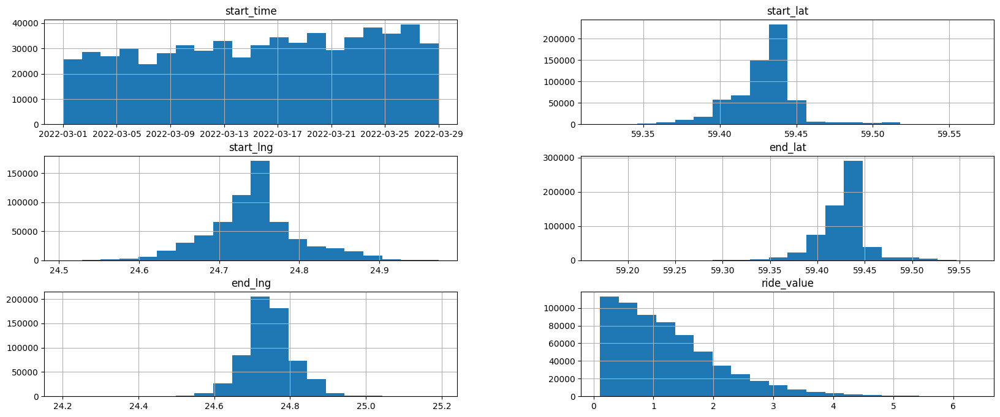

In [15]:
df.hist(figsize=(20, 8), bins=20);

In [16]:
print(f'We have lost about {round(((df_length_unmodified-df_length_modified)/df_length_unmodified) * 100, 2)} % of our data')

We have lost about 0.21 % of our data


## Intermediate conclusion

1. We have transformed our ``start_time`` column from object to datetime[s]. This will allow us to analyze this timeseries. Additionally, we have removed excessive [ns], but this did not affect the dataframe size since Pandas Series still stores the data about [ns], and this is more like a cosmetic improvement. 
2. We have transformed all other columns from the excessive float64 to optimal float32. This resulted in 41.81% of memory usage decrease and will save us a lot of computing time and cost in case we use big data.
3. The extreme outliers were removed from dataset. Now all columns (except of the ``ride_value`` and the ``start_time``) have more or less a shape of the normal distribution. However, we have removed only 0.21% of our data, which is great!

# Step 3: Explorative Data Analysis (EDA)

In [17]:
print(f"Total number of rides in the whole dataset: {df.groupby('start_time')['ride_value'].count().sum()}")

Total number of rides in the whole dataset: 625902


## 3.1 Start time 

Let's look how the taxi ordering pattern for the whole month looks like:

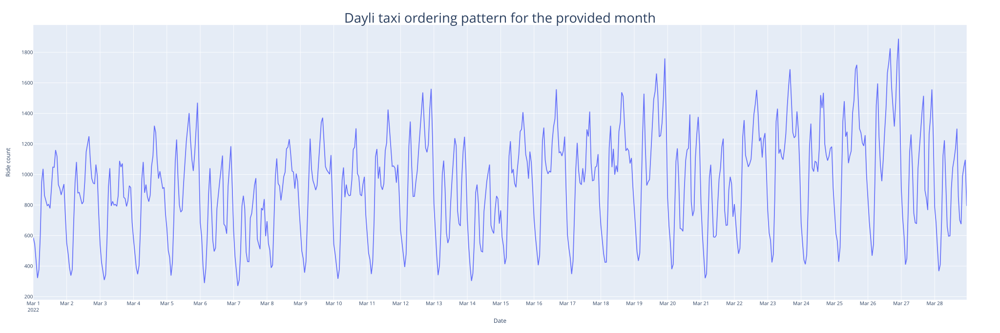

In [18]:
data_month = df.resample('H', on='start_time').count().ride_value.reset_index(name='number_of_rides')

fig = px.line(data_month, x='start_time', y='number_of_rides', labels={'number_of_rides': 'Ride count', 'start_time': 'Date'}, width=2400, height=800)
fig.update_layout(title={
        'text': 'Dayli taxi ordering pattern for the provided month',
        'y':0.96,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font_size': 32
    },
    xaxis=dict(nticks=30))
fig.show()

Let's analyze how many rides do we have per hour in a day

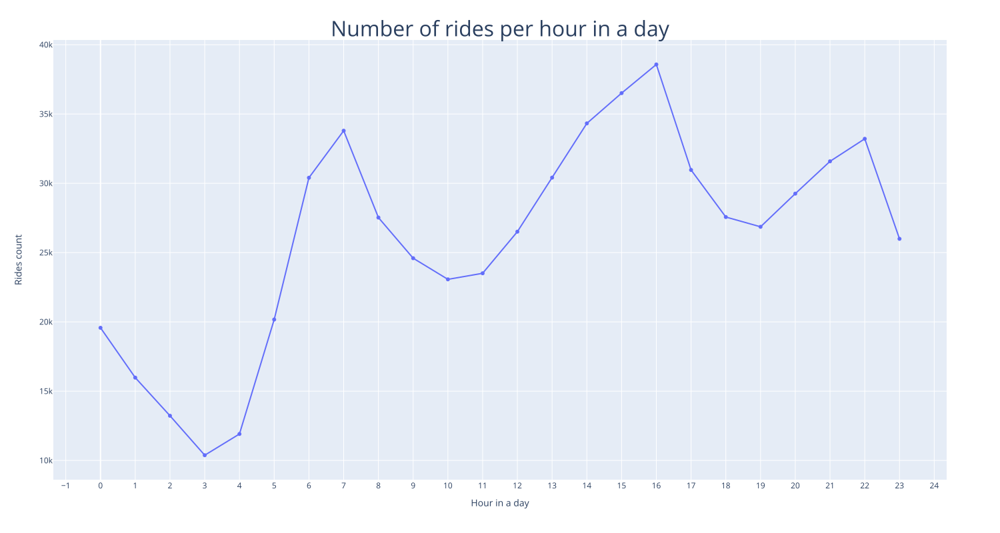

In [19]:
data_hours = df.groupby(df['start_time'].dt.hour)['ride_value'].count().reset_index(name='number_of_rides')
fig = px.line(data_hours, x=data_hours.index, y='number_of_rides', labels={'number_of_rides': 'Rides count', 'index': 'Hour in a day'}, width=1500, height=800, markers=True)
fig.update_layout(title={
        'text': 'Number of rides per hour in a day',
        'y':0.96,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font_size': 32
    },
    xaxis=dict(nticks=30))
fig.show()

## 3.2 Rides per each day

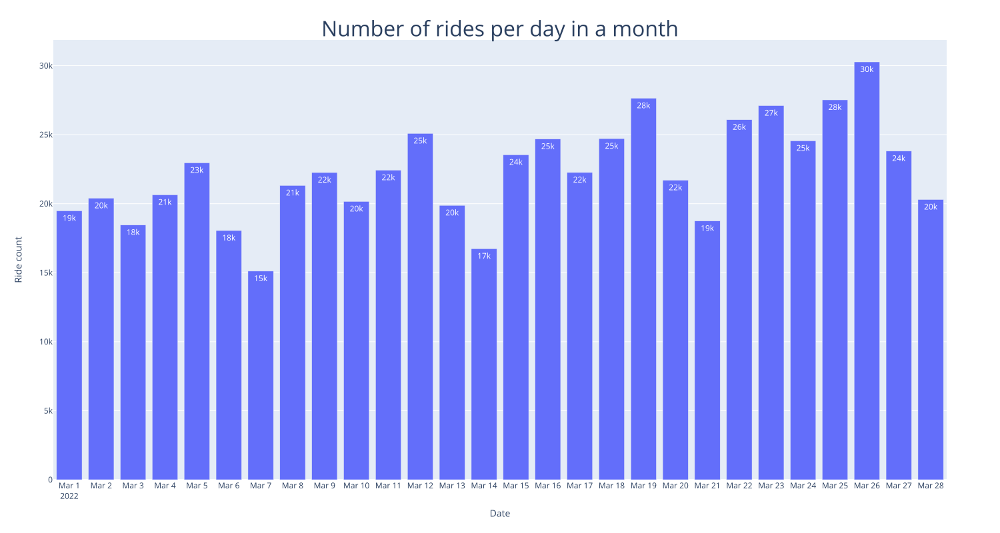

In [20]:
data_days = df.resample('D', on='start_time').count().ride_value.reset_index(name='rides_count')

fig = px.bar(data_days, x='start_time', y='rides_count', text_auto='.2s', labels={'rides_count': 'Ride count', 'start_time': 'Date'}, width=1500, height=800)
fig.update_layout(title={
        'text': 'Number of rides per day in a month',
        'y':0.96,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font_size': 32
    },
    xaxis=dict(nticks=30))
fig.show()

## 3.3 Rides per week number: 

In [21]:
data_weeks = df.resample('W', on='start_time').count().ride_value.reset_index(name='rides_count')
data_weeks['week_number'] = data_weeks['start_time'].dt.isocalendar().week - 8

data_weeks = data_weeks.drop('start_time', axis=1)
data_weeks

,rides_count,week_number
0,119981,1
1,146251,2
2,161280,3
3,178089,4
4,20301,5


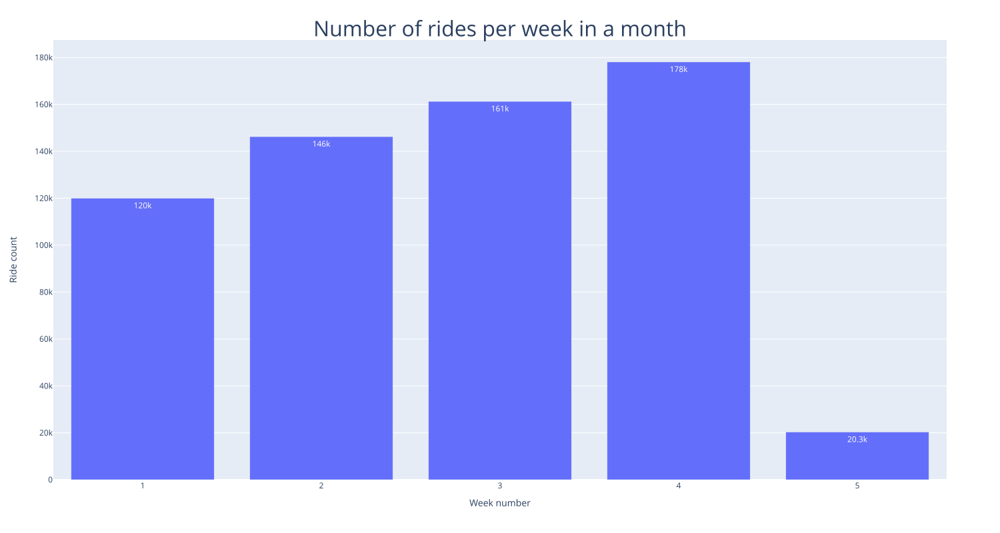

In [22]:
fig = px.bar(data_weeks, x='week_number', y='rides_count', text_auto='.3s', labels={'rides_count': 'Ride count', 'week_number': 'Week number'}, width=1500, height=800)
fig.update_layout(title={
        'text': 'Number of rides per week in a month',
        'y':0.96,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font_size': 32
    })
fig.show()


In [23]:
final_value = data_weeks.iloc[3]['rides_count']
initial_value = data_weeks.iloc[0]['rides_count']
percentage_increase = ((final_value - initial_value) / initial_value) * 100

print(f'The increase in orders number from the 1st week to the 4th week is: {round(percentage_increase)}%')

The increase in orders number from the 1st week to the 4th week is: 48%


## 3.4 Weekdays:

In [24]:
data_weekDays = df.resample('D', on='start_time').count().ride_value.reset_index(name='rides_count')
data_weekDays['day_name'] = data_weekDays['start_time'].dt.day_name()
data_weekDays['day_number'] = data_weekDays['start_time'].dt.dayofweek+1

data_weekDays = data_weekDays.groupby(['day_number', 'day_name'])[['rides_count']].sum().reset_index()
data_weekDays

,day_number,day_name,rides_count
0,1,Monday,70903
1,2,Tuesday,90428
2,3,Wednesday,94437
3,4,Thursday,85429
4,5,Friday,95302
5,6,Saturday,105962
6,7,Sunday,83441


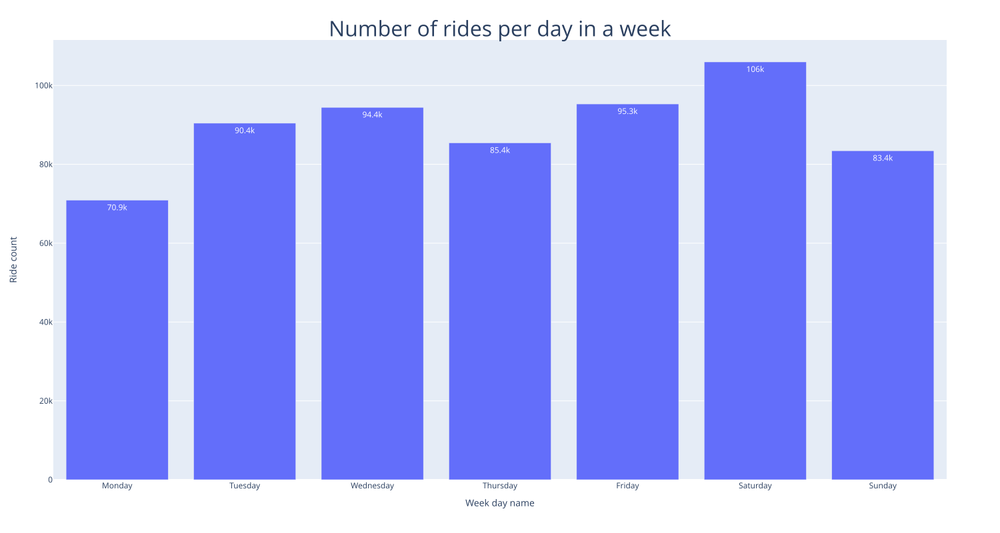

In [25]:
fig = px.bar(data_weekDays, x='day_name', y='rides_count', text_auto='.3s', labels={'rides_count': 'Ride count', 'day_name': 'Week day name'}, width=1500, height=800)
fig.update_layout(title={
        'text': 'Number of rides per day in a week',
        'y':0.96,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font_size': 32
    },
    xaxis=dict(nticks=30))
fig.show()

### Insights:
We can do the following conclusions based on the EDA of the ``start_time`` column:

1. The dayli taxi ordering pattern in the provided month looks very similar for most of the days. We often have 3 maximums (at 07:00, at 16:00, and at 22:00). This looks very logical since at 7:00 people tend to take a taxi to work, at 16:00 they tend to go from work back home or to have leisure, and the final peak at 22:00 means that people return back home from their leisure activities.
2. We can also observe a trend for increasing orders from the beginning to the end of the months. The increase in orders number from the 1st week to the 4th week is: 48%
3. As for the week days, we can see that the most orderds happen on Friday and Saturday (probably due to leisure activities on these days). Another 2 days with a lot of orders are Tuesdya nad Wednesday, probably due to working activities in the middle of the week.

## 3.5 Start Locations

In [26]:
color_scale = [(0, 'orange'), (1,'red')]

fig = px.scatter_mapbox(df, 
                        lat="start_lat", 
                        lon="start_lng", 
                        color_continuous_scale=color_scale,
                        zoom=11, 
                        height=1600,
                        width=1600)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_traces(marker=dict(size=2))
fig.show()

In [27]:
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675


## 3.6 Get the historical weather conditions for Tallinn for the given period.

Let's consider that the weather in the suburbs is the same for simplicity.

In [28]:
# Set time period
hw_start = datetime(2022, 3, 1)
hw_end = datetime(2022, 3, 29)

# Create Point for Tallinn
tallinn = Point(59.4370, 24.7536, 1)

# Get hourly data for the given period
weather_data = Hourly(tallinn, hw_start, hw_end)
weather_data = weather_data.fetch()
weather_data = weather_data.reset_index()

#### Columns explanation (only for those that we will use). Others can be found [here](https://dev.meteostat.net/docs/formats.html#data-structure):

* ``time`` - The datetime of the observation
* ``prcp`` - The one hour precipitation total in mm
* ``snow`` - The snow depth in mm
* ``coco`` - The weather condition code
* ``temp`` - The air temperature in °C

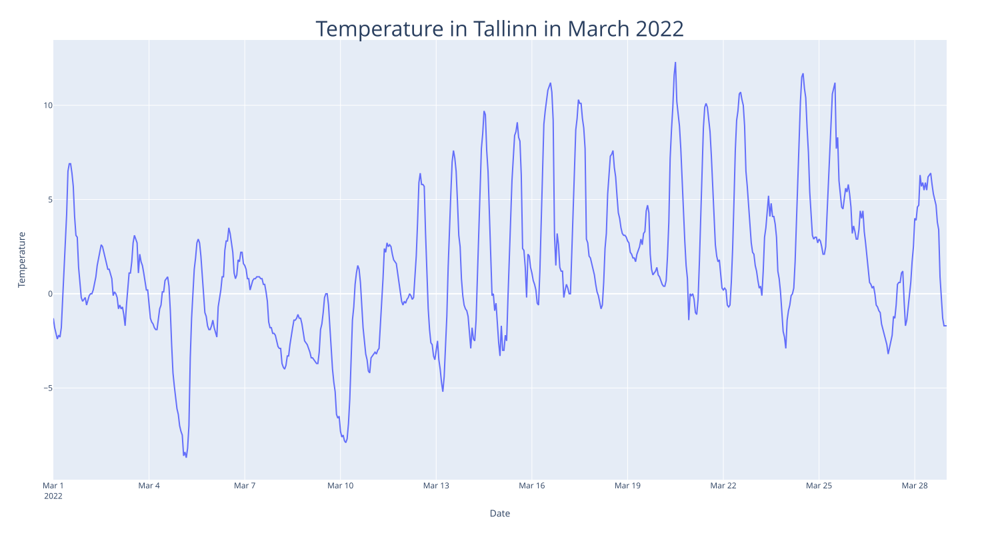

In [29]:
fig = px.line(weather_data, x='time', y='temp', labels={'temp': 'Temperature', 'time': 'Date'}, width=1500, height=800)
fig.update_layout(title={
        'text': 'Temperature in Tallinn in March 2022',
        'y':0.96,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font_size': 32
    })
fig.show()

#### Reduce the column dtypes from float64 to float16 since the float values are very small and simple:

In [30]:
for col in weather_data.columns:
    if weather_data[col].dtype == 'float64':
        weather_data[col] = weather_data[col].astype('float16')

#### Create a weather conditions code table according to the meteostat explanations [link](https://dev.meteostat.net/formats.html#weather-condition-codes):

In [31]:
weather_codes = {
    "code": [
        1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20,
        21, 22, 23, 24, 25, 26, 27
    ],
    "weather_condition": [
        "Clear", "Fair", "Cloudy", "Overcast", "Fog", "Freezing Fog",
        "Light Rain", "Rain", "Heavy Rain", "Freezing Rain", "Heavy Freezing Rain",
        "Sleet", "Heavy Sleet", "Light Snowfall", "Snowfall", "Heavy Snowfall",
        "Rain Shower", "Heavy Rain Shower", "Sleet Shower", "Heavy Sleet Shower",
        "Snow Shower", "Heavy Snow Shower", "Lightning", "Hail", "Thunderstorm",
        "Heavy Thunderstorm", "Storm"
    ]
}

weather_codes_df = pd.DataFrame(weather_codes)

#### Merge the weather data table and weather conditions code table:

In [32]:
weather_data_complete = pd.merge(weather_data, weather_codes_df, left_on='coco', right_on='code')

#### Merge our dataset with taxi orders with the weather data

In [33]:
df['hourly_time'] = df.start_time.dt.floor('H')
df = pd.merge(df, weather_data_complete[['time', 'weather_condition', 'temp', 'snow', 'prcp']], how='left', left_on='hourly_time', right_on='time')

# replace NaN values for snow
df.snow.fillna(0, inplace=True)

#### There are too many weather conditions. Let's make it simple. We will create a binary column with 1 = "good" and 0 = "bad" weather.

In [34]:
good_weather = ['Clear', 'Fair', 'Cloudy', 'Overcast']
df['weather_condition'] = df['weather_condition'].isin(good_weather).astype('int8')


In [35]:
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,time,weather_condition,temp,snow,prcp
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200,2022-03-01,2022-03-01,1,-1.299805,0.0,0.0
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500,2022-03-01,2022-03-01,1,-1.299805,0.0,0.0
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275,2022-03-01,2022-03-01,1,-1.299805,0.0,0.0
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725,2022-03-01,2022-03-01,1,-1.299805,0.0,0.0
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675,2022-03-01,2022-03-01,1,-1.299805,0.0,0.0


In [36]:
# Drop several unnecessary columns

df.drop(columns=['time'], inplace=True)

## 3.7 Location names

In [37]:
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,prcp
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200,2022-03-01,1,-1.299805,0.0,0.0
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500,2022-03-01,1,-1.299805,0.0,0.0
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275,2022-03-01,1,-1.299805,0.0,0.0
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725,2022-03-01,1,-1.299805,0.0,0.0
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675,2022-03-01,1,-1.299805,0.0,0.0


In [38]:
# Create a list of starting  coordinates from our dataset 
start_lat=df['start_lat'].to_list()
start_lng=df['start_lng'].to_list()
coords_start = list(zip(start_lat, start_lng))

# Create a list of end coordinates from our dataset 
end_lat=df['start_lat'].to_list()
end_lng=df['start_lng'].to_list()
coords_end = list(zip(end_lat, end_lng))

# Search the localities names 
results_start = rg.search(coords_start)
results_end = rg.search(coords_end)

start_locations_df = pd.DataFrame(results_start)
end_locations_df = pd.DataFrame(results_end)

Loading formatted geocoded file...


In [39]:
start_locations_df.head()

,lat,lon,name,admin1,admin2,cc
0,59.43696,24.75353,Tallinn,Harju,Tallinna linn,EE
1,59.43696,24.75353,Tallinn,Harju,Tallinna linn,EE
2,59.43696,24.75353,Tallinn,Harju,Tallinna linn,EE
3,59.43696,24.75353,Tallinn,Harju,Tallinna linn,EE
4,59.35083,24.61418,Laagri,Harju,Saue vald,EE


In [40]:
end_locations_df.head()

,lat,lon,name,admin1,admin2,cc
0,59.43696,24.75353,Tallinn,Harju,Tallinna linn,EE
1,59.43696,24.75353,Tallinn,Harju,Tallinna linn,EE
2,59.43696,24.75353,Tallinn,Harju,Tallinna linn,EE
3,59.43696,24.75353,Tallinn,Harju,Tallinna linn,EE
4,59.35083,24.61418,Laagri,Harju,Saue vald,EE


In [41]:
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,prcp
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200,2022-03-01,1,-1.299805,0.0,0.0
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500,2022-03-01,1,-1.299805,0.0,0.0
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275,2022-03-01,1,-1.299805,0.0,0.0
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725,2022-03-01,1,-1.299805,0.0,0.0
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675,2022-03-01,1,-1.299805,0.0,0.0


#### The reverse_geocoder library get our coordinates and returns back the coordinates of the centers of the settlements. So we can't correctly join the tables based on the coordinates. The tables have the same lenghts and correspond to each other. So we will do it simply.

In [42]:
df['start_location'] = start_locations_df['name']
df['end_location'] = end_locations_df['name']

In [43]:
df.sample(10)

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,prcp,start_location,end_location
501352,2022-03-24 03:31:06,59.425308,24.745140,59.438595,24.770325,0.507750,2022-03-24 03:00:00,1,-0.099976,0.0,0.0,Tallinn,Tallinn
336562,2022-03-17 08:02:18,59.393539,24.721149,59.443607,24.717396,1.386980,2022-03-17 08:00:00,1,6.199219,0.0,0.0,Tallinn,Tallinn
356620,2022-03-18 05:47:41,59.375347,24.644264,59.431835,24.731491,1.980250,2022-03-18 05:00:00,1,-0.600098,0.0,0.0,Laagri,Laagri
29076,2022-03-02 13:34:08,59.415451,24.700125,59.449955,24.696852,0.958500,2022-03-02 13:00:00,1,2.500000,0.0,0.0,Tallinn,Tallinn
119574,2022-03-06 23:32:27,59.433872,24.768099,59.427364,24.773893,0.205715,2022-03-06 23:00:00,1,1.599609,0.0,0.0,Tallinn,Tallinn
508901,2022-03-24 11:26:17,59.408775,24.686335,59.430698,24.750296,1.075750,2022-03-24 11:00:00,1,11.500000,0.0,0.0,Tallinn,Tallinn
423081,2022-03-20 20:27:35,59.443371,24.756990,59.409718,24.734278,0.985500,2022-03-20 20:00:00,1,1.500000,0.0,0.0,Tallinn,Tallinn
614663,2022-03-28 12:30:13,59.426495,24.652336,59.452904,24.874395,3.167000,2022-03-28 12:00:00,1,6.398438,0.0,0.0,Laagri,Laagri
517050,2022-03-24 17:41:56,59.441742,24.763103,59.435852,24.769068,0.174399,2022-03-24 17:00:00,1,5.398438,0.0,0.0,Tallinn,Tallinn
398306,2022-03-19 18:45:29,59.430965,24.768225,59.429028,24.748543,0.273333,2022-03-19 18:00:00,1,1.299805,0.0,0.0,Tallinn,Tallinn


#### Let's look at the rows where the start location equals to the end location:

In [44]:
df[df['start_location'] == df['end_location']]

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,prcp,start_location,end_location
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.352000,2022-03-01 00:00:00,1,-1.299805,0.0,0.0,Tallinn,Tallinn
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.495000,2022-03-01 00:00:00,1,-1.299805,0.0,0.0,Tallinn,Tallinn
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.552750,2022-03-01 00:00:00,1,-1.299805,0.0,0.0,Tallinn,Tallinn
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.737250,2022-03-01 00:00:00,1,-1.299805,0.0,0.0,Tallinn,Tallinn
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.286750,2022-03-01 00:00:00,1,-1.299805,0.0,0.0,Laagri,Laagri
...,...,...,...,...,...,...,...,...,...,...,...,...,...
625897,2022-03-28 23:59:19,59.434212,24.560812,59.436172,24.831474,3.755750,2022-03-28 23:00:00,0,-1.700195,0.0,0.0,Tabasalu,Tabasalu
625898,2022-03-28 23:59:19,59.441574,24.739100,59.466717,24.832512,1.467973,2022-03-28 23:00:00,0,-1.700195,0.0,0.0,Tallinn,Tallinn
625899,2022-03-28 23:59:22,59.430172,24.773987,59.435509,24.819229,0.644750,2022-03-28 23:00:00,0,-1.700195,0.0,0.0,Tallinn,Tallinn
625900,2022-03-28 23:59:42,59.434750,24.746042,59.445610,24.697914,0.732500,2022-03-28 23:00:00,0,-1.700195,0.0,0.0,Tallinn,Tallinn


#### Let's look at the rows where the start location NOT equals to the end location:

In [45]:
df[df['start_location'] != df['end_location']]

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,prcp,start_location,end_location


### We can conclude that in this dataset, all the trips are conducted within one settlement in the area of Tallinn

### Average speeds in Tallinn and suburbs

Another interesting resource to get the info about the traffic conditions in Tallinn is: https://www.tomtom.com/traffic-index/tallinn-traffic/

However, they use pretty complex JS on their page and scrapping this info is not a trivial task. I have spent several hours trying to do that with no luck. I will get the data here in the follwoing way:
1. Long right-click, drag and copy directly from the web-page.
2. Create a df out of the data. 

In [46]:
data = {
    "Sunday": [40, 41, 42, 42, 42, 42, 42, 41, 40, 39, 38, 36, 36, 35, 35, 35, 35, 35, 35, 36, 37, 37, 39, 41],
    "Monday": [42, 43, 43, 44, 46, 45, 43, 32, 26, 29, 33, 33, 32, 32, 32, 30, 27, 24, 31, 34, 35, 36, 38, 39],
    "Tuesday": [42, 43, 43, 44, 45, 44, 42, 32, 26, 28, 32, 32, 32, 31, 31, 30, 26, 24, 29, 34, 35, 36, 38, 39],
    "Wednesday": [42, 43, 43, 44, 45, 44, 42, 32, 27, 29, 33, 32, 32, 31, 31, 30, 26, 24, 30, 34, 35, 36, 38, 39],
    "Thursday": [42, 43, 43, 43, 45, 44, 42, 33, 27, 30, 33, 33, 31, 31, 30, 30, 27, 25, 30, 33, 35, 36, 38, 39],
    "Friday": [42, 43, 43, 43, 44, 44, 43, 34, 30, 32, 33, 32, 31, 31, 30, 29, 26, 27, 30, 33, 35, 35, 37, 38],
    "Saturday": [40, 41, 41, 42, 42, 42, 41, 41, 40, 38, 37, 35, 34, 33, 34, 34, 34, 34, 34, 35, 36, 36, 38, 39]
}

tallin_speed_df = pd.DataFrame(data, index=[hour for hour in range(24)])
tallin_speed_df

,Sunday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday
0,40,42,42,42,42,42,40
1,41,43,43,43,43,43,41
2,42,43,43,43,43,43,41
3,42,44,44,44,43,43,42
4,42,46,45,45,45,44,42
5,42,45,44,44,44,44,42
6,42,43,42,42,42,43,41
7,41,32,32,32,33,34,41
8,40,26,26,27,27,30,40
9,39,29,28,29,30,32,38


In [47]:
data_metro_area = {
    "Sunday": [47, 47, 47, 47, 47, 48, 48, 49, 49, 47, 47, 45, 45, 44, 44, 44, 44, 43, 44, 44, 45, 45, 46, 47],
    "Monday": [48, 49, 48, 49, 52, 52, 51, 41, 34, 37, 40, 40, 39, 39, 39, 38, 35, 33, 38, 41, 42, 43, 44, 45],
    "Tuesday": [47, 48, 48, 49, 51, 51, 50, 40, 34, 36, 40, 39, 38, 38, 38, 37, 34, 32, 37, 40, 41, 42, 44, 45],
    "Wednesday": [47, 48, 48, 49, 51, 51, 50, 41, 35, 37, 40, 39, 38, 38, 38, 37, 34, 33, 37, 40, 41, 42, 44, 45],
    "Thursday": [47, 48, 47, 48, 50, 51, 50, 41, 36, 38, 40, 39, 38, 38, 38, 37, 35, 34, 37, 40, 42, 42, 45, 46],
    "Friday": [48, 48, 48, 48, 50, 51, 50, 42, 38, 40, 40, 40, 38, 38, 38, 37, 35, 36, 38, 40, 41, 42, 43, 44],
    "Saturday": [46, 46, 46, 46, 47, 48, 49, 50, 49, 47, 46, 44, 43, 42, 42, 42, 42, 42, 42, 43, 43, 43, 45, 45]
}

suburbs_speed_df = pd.DataFrame(data_metro_area, index=[hour for hour in range(24)])
suburbs_speed_df

,Sunday,Monday,Tuesday,Wednesday,Thursday,Friday,Saturday
0,47,48,47,47,47,48,46
1,47,49,48,48,48,48,46
2,47,48,48,48,47,48,46
3,47,49,49,49,48,48,46
4,47,52,51,51,50,50,47
5,48,52,51,51,51,51,48
6,48,51,50,50,50,50,49
7,49,41,40,41,41,42,50
8,49,34,34,35,36,38,49
9,47,37,36,37,38,40,47


In [48]:
# Create some columns for proper merging

df['week_day'] = df['start_time'].dt.day_name()
df['hour'] = df['hourly_time'].dt.hour
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,prcp,start_location,end_location,week_day,hour
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675,2022-03-01,1,-1.299805,0.0,0.0,Laagri,Laagri,Tuesday,0


In [49]:
def get_avg_speeds(row):
    
    start_location = row['start_location']
    end_location = row['end_location']
    day = row['week_day']
    hour = row['hour']

    # Case when both start and end locations are the same
    if start_location == end_location:
        if start_location == 'Tallinn' and end_location == 'Tallinn':  # If both locations are in Tallinn
            return tallin_speed_df.at[hour, day]
        else:  # Both locations are the same but not in Tallinn
            return suburbs_speed_df.at[hour, day]

    # Case when start and end locations are different
    else:
        if 'Tallinn' in (start_location, end_location):
            return round((tallin_speed_df.at[hour, day] + suburbs_speed_df.at[hour, day]) / 2, 1)
        
        else:
            return suburbs_speed_df.at[hour, day]

# Apply the function to the DataFrame
df['avg_speed_kmh'] = df.apply(get_avg_speeds, axis=1)
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,prcp,start_location,end_location,week_day,hour,avg_speed_kmh
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675,2022-03-01,1,-1.299805,0.0,0.0,Laagri,Laagri,Tuesday,0,47


#### Let's count locations with the highest taxi demand and the highest total generated value.

In [50]:
location_values = df.groupby('start_location')['ride_value'].sum().to_frame().reset_index().sort_values('ride_value', ascending=False)
location_values['ride_value'] = location_values['ride_value'].astype(int)

In [51]:
location_ride_counts = df.start_location.value_counts().to_frame().reset_index()

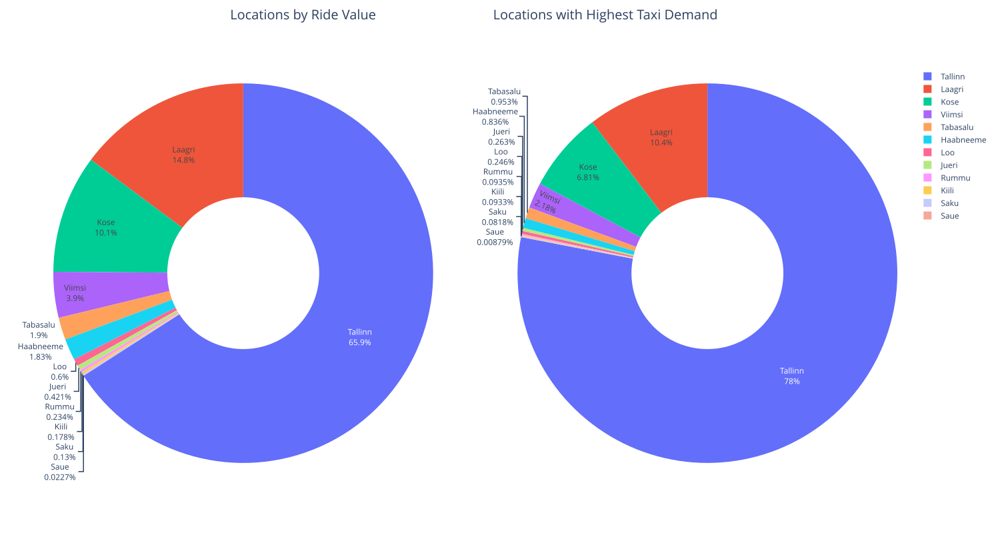

In [52]:
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'pie'}, {'type':'pie'}]])

# First Pie Chart
fig.add_trace(
    go.Pie(
        labels=location_values['start_location'],
        values=location_values['ride_value'],
        name="Ride Value",
        textinfo='label+percent',
        hole=0.4
    ),
    row=1, col=1
)

# Second Pie Chart
fig.add_trace(
    go.Pie(
        labels=location_ride_counts['start_location'],
        values=location_ride_counts['count'],
        name="Taxi Demand",
        textinfo='label+percent',
        hole=0.4
    ),
    row=1, col=2
)

# Update layout for titles and overall aesthetics
fig.update_layout(
    annotations=[
        dict(text='Locations by Ride Value', x=0.20, xref='paper', y=1.15, yref='paper', showarrow=False, font_size=20),
        dict(text='Locations with Highest Taxi Demand', x=0.80, xref='paper', y=1.15, yref='paper', showarrow=False, font_size=20)
    ],
    width=1500, height=800
)

# Show the figure
fig.show()

#### Insights:
* The most valuable rides start somewhere in the are of (59.44, 24.735). This point is around the city center of Tallinn (near the central train station) and that has a lot of sense.
* The start_time has no influence on the higher values of the ride_value.
* Temperatures near 0 degrees Celsius have correlations with higher ride_value.
* The most expensive rides and more rides in gemeral happen when there is no snow or rain. Snow has a negative correlation with the ride_value.

#### Generate datasets that will differentiate rides in the suburbs and the capital:

In [53]:
tallinn_df = df[df.start_location == 'Tallinn']
suburbs_df = df[df.start_location != 'Tallinn']

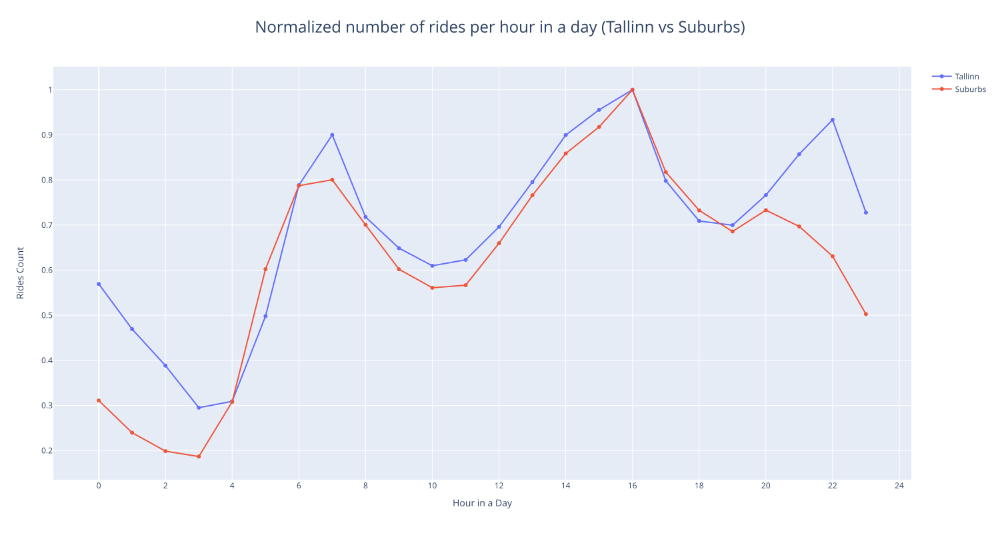

In [54]:
suburbs_data_hours = suburbs_df.groupby(df['start_time'].dt.hour)['ride_value'].count().reset_index(name='number_of_rides')
tallinn_data_hours = tallinn_df.groupby(df['start_time'].dt.hour)['ride_value'].count().reset_index(name='number_of_rides')

# Normalize each dataset by the maximum number of rides
tallinn_data_hours['normalized_rides'] = tallinn_data_hours['number_of_rides'] / tallinn_data_hours['number_of_rides'].max()
suburbs_data_hours['normalized_rides'] = suburbs_data_hours['number_of_rides'] / suburbs_data_hours['number_of_rides'].max()

fig = go.Figure()

# Trace for Tallinn data
fig.add_trace(go.Scatter(
    x=tallinn_data_hours['start_time'], 
    y=tallinn_data_hours['normalized_rides'],
    mode='lines+markers',
    name='Tallinn'
))

# Trace for Suburbs data
fig.add_trace(go.Scatter(
    x=suburbs_data_hours['start_time'], 
    y=suburbs_data_hours['normalized_rides'],
    mode='lines+markers',
    name='Suburbs'
))

# Update layout to unify the design
fig.update_layout(
    title={
        'text': 'Normalized number of rides per hour in a day (Tallinn vs Suburbs)',
        'y':0.96,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top',
        'font_size': 24
    },
    xaxis=dict(
        title='Hour in a Day',
        nticks=23
    ),
    yaxis=dict(
        title='Rides Count'
    ),
    width=1500,
    height=800
)

fig.show()

In [55]:
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,prcp,start_location,end_location,week_day,hour,avg_speed_kmh
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675,2022-03-01,1,-1.299805,0.0,0.0,Laagri,Laagri,Tuesday,0,47


## 3.8 Distance calculations:

##### [This article](https://www.linkedin.com/pulse/calculating-distances-using-python-google-maps-r%C3%A9gis-nisengwe/) gives a nice example on how to calculate real distances and travel times between points on a map using Google API. In order to calculate this for all the points in the dataset would cost me around 2500$, so I would like to avoid it.
Other articles, like [this one](https://medium.com/analytics-vidhya/measure-driving-distance-time-and-plot-routes-between-two-geographical-locations-using-python-39995dfea7e), or [this one](https://github.com/vaclavdekanovsky/data-analysis-in-examples/blob/master/Maps/Driving%20Distance/Driving%20Distance%20between%20two%20places.ipynb) also require API keys, which are free but only for several hundred calls maximum. 

In [56]:
print(f'The price of Google API: {round(len(df)/1000*4,1)} $')

The price of Google API: 2503.6 $


##### Another possible way how to do it is using the osrm-project engine. The issue with this approach is that it is pretty slow and returns around 2 API-calls per second. This will result in around 85 hours of running time to fill all our data if the server will not block our connection.

In [57]:
# import pandas as pd
# import requests
# from concurrent.futures import ThreadPoolExecutor, as_completed

# # Function to fetch distance and duration
# def fetch_distance_and_duration(row, index, total):
#     start = f"{row['start_lng']},{row['start_lat']}"
#     end = f"{row['end_lng']},{row['end_lat']}"
#     url = f'http://router.project-osrm.org/route/v1/driving/{start};{end}?alternatives=false'
#     response = requests.get(url)
#     if response.status_code == 200:
#         data = response.json()
#         distance = data['routes'][0]['distance']  # distance in meters
#         duration = data['routes'][0]['duration']  # duration in seconds
#         print(f"Processed row {index+1}/{total}: Success")
#         return (row['start_lat'], row['start_lng'], row['end_lat'], row['end_lng'], distance, duration)
#     else:
#         print(f"Processed row {index+1}/{total}: Failed with status code {response.status_code}")
#         return (row['start_lat'], row['start_lng'], row['end_lat'], row['end_lng'], None, None)

# # List for storing results
# results = []
# total = len(df)

# # Using ThreadPoolExecutor to handle parallel requests
# with ThreadPoolExecutor(max_workers=10) as executor:
#     futures = {executor.submit(fetch_distance_and_duration, row, index, total): index for index, row in df.iterrows()}
#     for future in as_completed(futures):
#         results.append(future.result())

# # Create a new DataFrame from the results
# columns = ['start_lat', 'start_lng', 'end_lat', 'end_lng', 'distance', 'duration']
# results_df = pd.DataFrame(results, columns=columns)

# print("New DataFrame with distance and duration:")
# print(results_df.head())


##### Since we have rides that take place in the urban environment, let's use the Manhattan distance as a relatively fair distance approximation for our case (since we do not have any fancy API with real maps):

In [58]:

def manhattan_distance(lat1, lng1, lat2, lng2):
    # Convert degrees to radians
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lng1, lat2, lng2])
    
    # Calculate differences in coordinates
    dlat = np.abs(lat2 - lat1)
    dlon = np.abs(lon2 - lon1)

    # Radius of Earth in meters
    R = 6371000  # in meters

    # Convert radial differences to linear distances (approximation)
    lat_dist = dlat * R
    lon_dist = dlon * (R * np.cos((lat1 + lat2) / 2))

    # Return Manhattan distance in meters
    return round(lat_dist + lon_dist)

# Apply the function across rows of the DataFrame
df['distance_m'] = df.apply(lambda x: manhattan_distance(x['start_lat'], x['start_lng'], x['end_lat'], x['end_lng']), axis=1)


In [59]:
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,prcp,start_location,end_location,week_day,hour,avg_speed_kmh,distance_m
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42,16965
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42,7503
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42,2448
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42,8396
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675,2022-03-01,1,-1.299805,0.0,0.0,Laagri,Laagri,Tuesday,0,47,11916


## 3.9 Driving time calculations

Let's calculate the driving time in minutes and round up the resulting values to the next minute.

In [60]:
df['driving_time_min'] = np.ceil(df['distance_m'] / 1000 / df['avg_speed_kmh'] * 60)

In [61]:
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,prcp,start_location,end_location,week_day,hour,avg_speed_kmh,distance_m,driving_time_min
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42,16965,25.0
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42,7503,11.0
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42,2448,4.0
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725,2022-03-01,1,-1.299805,0.0,0.0,Tallinn,Tallinn,Tuesday,0,42,8396,12.0
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675,2022-03-01,1,-1.299805,0.0,0.0,Laagri,Laagri,Tuesday,0,47,11916,16.0


The lowest distance for the ride is 6 meters. Let's remove the rides that are less than 500 meters, this data is very strange and I do not think that it is valuable or representative. We have 10512 entries like this.

In [62]:
df['distance_m'].min()

6

In [63]:
len(df[df['distance_m'] < 500])

10512

In [64]:
df = df[df['distance_m']>= 500]

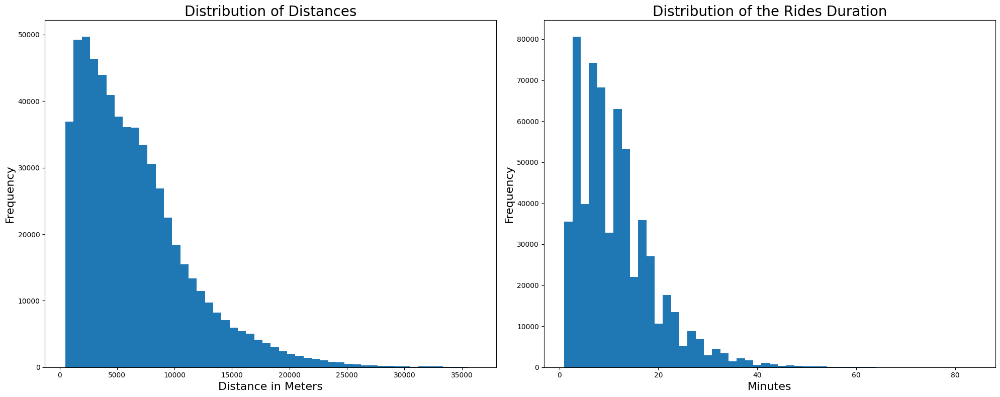

In [65]:
# Create a figure and a set of subplots
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 8))

# Histogram for distances
axes[0].hist(df['distance_m'], bins=50)
axes[0].set_title('Distribution of Distances', fontsize=20)
axes[0].set_xlabel('Distance in Meters', fontsize=16)
axes[0].set_ylabel('Frequency', fontsize=16)

# Histogram for driving times
axes[1].hist(df['driving_time_min'], bins=50)
axes[1].set_title('Distribution of the Rides Duration', fontsize=20)
axes[1].set_xlabel('Minutes', fontsize=16)
axes[1].set_ylabel('Frequency', fontsize=16)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show plot
plt.show()


## 3.10 Feature correlations

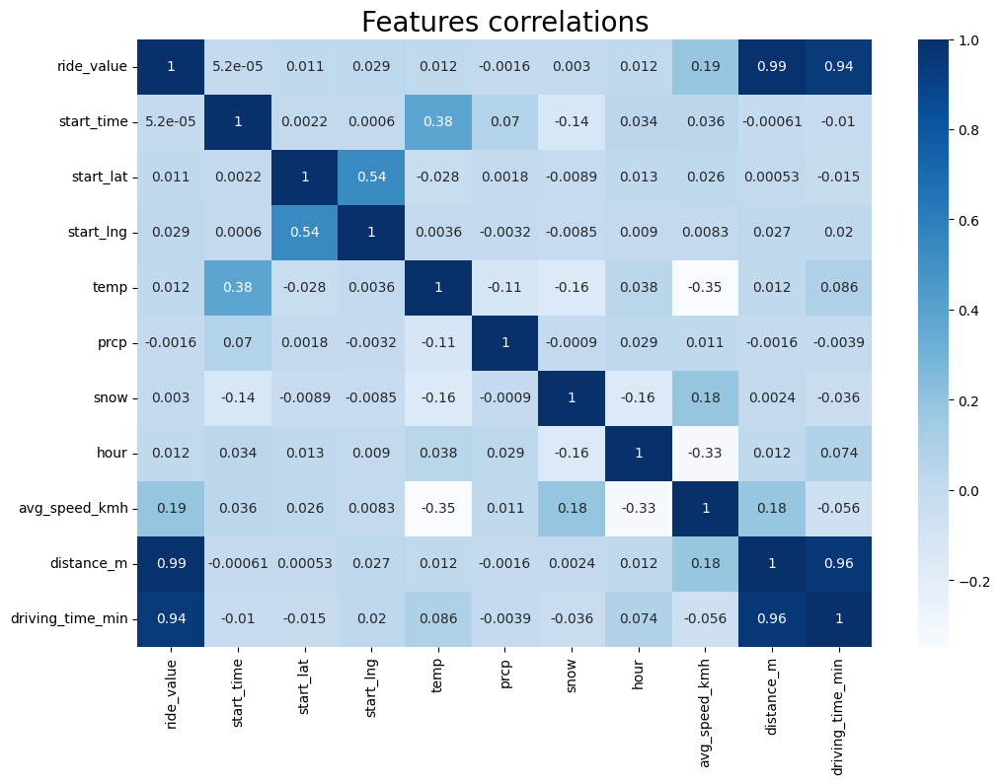

In [66]:
plt.figure(figsize=(12, 8))
sns.heatmap(df[['ride_value', 'start_time', 'start_lat', 'start_lng', 'temp', 'prcp', 'snow', 'hour', 'avg_speed_kmh', 'distance_m', 'driving_time_min']].corr(), cmap='Blues', annot=True)
plt.title('Features correlations', size=20)
plt.show()

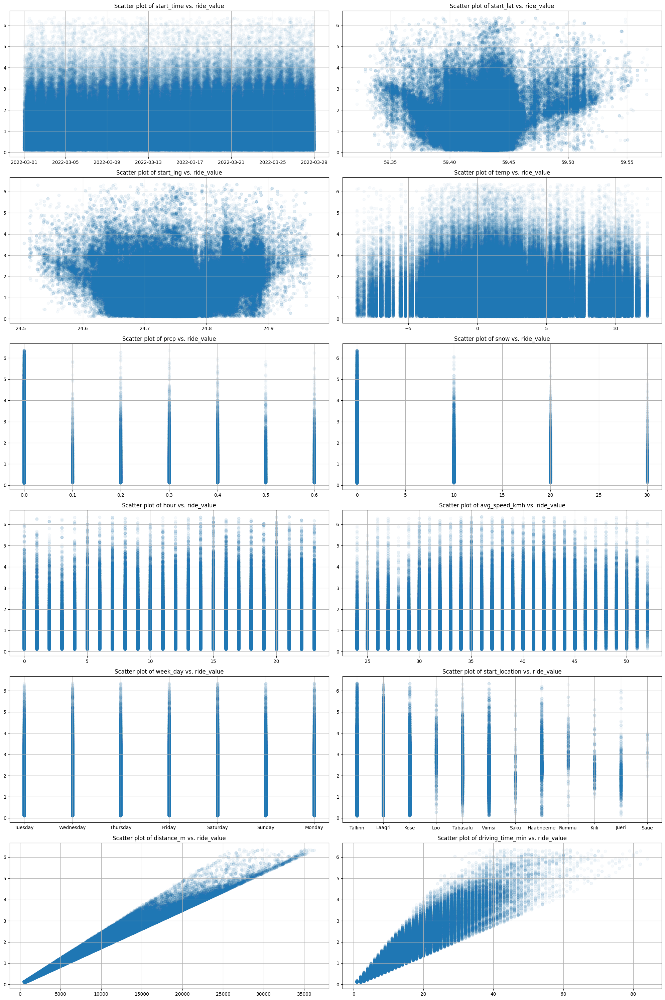

In [67]:
column_names = ['start_time', 'start_lat', 'start_lng', 'temp', 'prcp', 'snow', 'hour', 'avg_speed_kmh', 'week_day', 'start_location', 'distance_m', 'driving_time_min']

# Define the number of rows and columns for the subplot grid
n_rows = 6
n_cols = 2

fig, axs = plt.subplots(n_rows, n_cols, figsize=(20, 30))  

# Flatten the array of axes to make iterating easier
axs = axs.flatten()

# Loop through the column names and create a scatter plot in each subplot
for i, column in enumerate(column_names):
    axs[i].scatter(df[column], df['ride_value'], alpha=0.03)
    axs[i].set_title(f'Scatter plot of {column} vs. ride_value')
    axs[i].grid(True)

plt.tight_layout()

# Show the plot
plt.show()

#### Airport historical data

Unfortunately I couldn't find any historical datasets for the Tallinn airport.

## 3.11 Add holidays and weekends

In [68]:
est_holidays = holidays.country_holidays('EE')

df['date'] = df['start_time'].dt.date
df['day_of_month'] = df['start_time'].dt.day

df['is_holiday'] = df['date'].apply(lambda x: x in est_holidays)

df['day_of_week'] = df['start_time'].dt.dayofweek + 1

df['is_weekend'] = df['day_of_week'].isin([6, 7]).astype('int8')

In [69]:
df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,hourly_time,weather_condition,temp,snow,...,week_day,hour,avg_speed_kmh,distance_m,driving_time_min,date,day_of_month,is_holiday,day_of_week,is_weekend
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200,2022-03-01,1,-1.299805,0.0,...,Tuesday,0,42,16965,25.0,2022-03-01,1,False,2,0
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500,2022-03-01,1,-1.299805,0.0,...,Tuesday,0,42,7503,11.0,2022-03-01,1,False,2,0
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275,2022-03-01,1,-1.299805,0.0,...,Tuesday,0,42,2448,4.0,2022-03-01,1,False,2,0
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725,2022-03-01,1,-1.299805,0.0,...,Tuesday,0,42,8396,12.0,2022-03-01,1,False,2,0
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675,2022-03-01,1,-1.299805,0.0,...,Tuesday,0,47,11916,16.0,2022-03-01,1,False,2,0


#### Final table preprocessing before the next step

In [70]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 615390 entries, 0 to 625901
Data columns (total 23 columns):
 #   Column             Non-Null Count   Dtype        
---  ------             --------------   -----        
 0   start_time         615390 non-null  datetime64[s]
 1   start_lat          615390 non-null  float32      
 2   start_lng          615390 non-null  float32      
 3   end_lat            615390 non-null  float32      
 4   end_lng            615390 non-null  float32      
 5   ride_value         615390 non-null  float32      
 6   hourly_time        615390 non-null  datetime64[s]
 7   weather_condition  615390 non-null  int8         
 8   temp               615390 non-null  float16      
 9   snow               615390 non-null  float16      
 10  prcp               615390 non-null  float16      
 11  start_location     615390 non-null  object       
 12  end_location       615390 non-null  object       
 13  week_day           615390 non-null  object       
 14  hour     

#### Drop some unnecessary columns: e.g. 'end_location' always equals the 'star_location' so we do not need it.

In [71]:
df = df.drop(columns=(['hourly_time', 'end_location', 'date']))

In [72]:
int8_columns = ['driving_time_min', 'temp', 'day_of_month', 'snow', 'hour', 'avg_speed_kmh', 'is_holiday', 'day_of_week']
for col in int8_columns:
    df[col] = df[col].astype('int8')

df['distance_m'] = df['distance_m'].astype('int32')

category_columns = ['week_day', 'start_location']
for col in category_columns:
    df[col] = df[col].astype('category')

In [73]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 615390 entries, 0 to 625901
Data columns (total 20 columns):
 #   Column             Non-Null Count   Dtype        
---  ------             --------------   -----        
 0   start_time         615390 non-null  datetime64[s]
 1   start_lat          615390 non-null  float32      
 2   start_lng          615390 non-null  float32      
 3   end_lat            615390 non-null  float32      
 4   end_lng            615390 non-null  float32      
 5   ride_value         615390 non-null  float32      
 6   weather_condition  615390 non-null  int8         
 7   temp               615390 non-null  int8         
 8   snow               615390 non-null  int8         
 9   prcp               615390 non-null  float16      
 10  start_location     615390 non-null  category     
 11  week_day           615390 non-null  category     
 12  hour               615390 non-null  int8         
 13  avg_speed_kmh      615390 non-null  int8         
 14  distance_

In [74]:
print(f'We have reduced the memory consumption by: {round(((71 - 31.7)/71 * 100))} %')

We have reduced the memory consumption by: 55 %


Copy the preprocessed dataset

In [75]:
data = df.copy()

### Intermediate conclusion:

The EDA was performed in this step and here are the findings:
1. We saw that the dayli taxi order pattern in the whole area is very similar with several peaks at 7:00, 16:00, and 22:00.
2. By the end of the month, the amount of order increases by around 30%.
3. The most ride-busy day is Saturday.
4. The starting locations were plotted on the map. THey cover the whole Tallinn metropolitan area.
5. Weather conditions were added to the dataset. For simplicity, let's assume that the same weather takes place in the whole metropolitan area.
6. Location names were added to the starting and ending locations. It turns out that all the rides take place end end in the same settlements, e.g. if a ride starts in Tallin, it also ends only in Tallinn.
7. Average speeds for tallinn and suburbs were added. For simplicity, let's assume that the avg speeds in the Tallinn city center and outside of it are the same.
8. Most of taxi orders take place in Tallinn (78%). And 66% of all value generated from the taxi rides is also in Tallinn.
9. The ride patterns for the capital and suburbs differ a little bit (suburbs do not have such a sharp peak at 22:00).
10. Based on the average speed we have also calculated the average distances based on the Manhattan distance since API for proper calculations either too costly or to slow.
11. Based on the distances and average speed, the time of each treap was also estimated. Most of trips are less than 10 km, while the maximum lentgth is about 35 km.
12. Most of the ride durations are below 20 minutes.
13. Correlations suggest that the most important facor for the ride_value calculations are (surprise-surprise):
    * Distance (0.99 correlation)
    * Driving time (0.94 correlation)
    * Speed (0.19 correlation)

14. Holidays and weekends were also added to the dataset.
15. The dataset was optimized for memory consumption by around 55%.

# Step 4: Data preparation for the ML part

## 4.1 Create helper functions

### Function: data_splitter()

Split our dataset in parts. We will use cross-validation, that is why we do not need a separate validation dataset.
* Train: 80%
* Test: 20% (to test the final model)

In [76]:
def data_splitter(data, testSize = 0.2):

    # splitting the train-test data
    train, test = train_test_split(data, test_size=testSize, random_state=42)

    # assigning features and targets for train and test samples
    X_train = train.drop('rides_count', axis=1)
    y_train = train['rides_count']
    
    X_test = test.drop('rides_count', axis=1)
    y_test = test['rides_count']

    print('X_train: {0} ({1}%)'.format(X_train.shape[0], (X_train.shape[0]/data.shape[0])*100))
    print('y_train: {0} ({1}%)'.format(y_train.shape[0], (y_train.shape[0]/data.shape[0])*100))
    print()
    print('X_test: {0} ({1}%)'.format(X_test.shape[0], (X_test.shape[0]/data.shape[0])*100))
    print('y_test: {0} ({1}%)'.format(y_test.shape[0], (y_test.shape[0]/data.shape[0])*100))
    
    return X_train, y_train, X_test, y_test

### Function: plot_real_vs_pred()

Plotting real and predicted data.

In [77]:

def plot_real_vs_pred(model_name, y_real, y_pred):
    plt.style.use('ggplot')
    reg_real_vs_pred = pd.DataFrame({'Actual': y_real, 'Predicted': y_pred})
    reg_real_vs_pred = reg_real_vs_pred.head(40)
    reg_real_vs_pred.plot(kind='bar', title='MODEL: '+model_name, figsize=(18,5))
    plt.show()

### Function: basemodel_predict()
Get predictions of the baseline model

In [78]:
def basemodel_predict(base, X_test):    
    # Preparing the output array
    output = []
    
    # Iterate through the test set
    for index, row in X_test.iterrows():
        # Fetching the baseline average from the DataFrame
        # Now also filtering by hour along with time_bin
        mask = (base['cluster'] == row['cluster']) & (base['time_bin'] == row['time_bin']) & (base['hour'] == row['hour'])
        filtered_base = base[mask]
        
        if not filtered_base.empty:
            average_rides = filtered_base['average_rides'].iloc[0]
            output.append(int(average_rides))
        else:
            # Handle missing data if no matches found for the cluster, time_bin, and hour combination
            default_value = base['average_rides'].mean()
            output.append(int(default_value))

    return np.array(output)


### Function: get_metrics()

Function to calculate all relevant metrics.

* Inputs: ``model name``, ``real target values``, ``predicted values``.
* Outputs: ``model name``, ``MAE``, ``RMSE``, ``R^2``, ``R (correlation)``.

In [79]:
def get_metrics(model_name, y_real, y_pred, to_print=True):
    # MAE: same units as target variable. It is more robust to outliers
    MAE = mean_absolute_error(y_real, y_pred)
    
    if to_print:
        print(f'MODEL: {model_name}')
        print(f'MAE: {round(MAE, 2)}')
    
    return model_name, MAE


### Function: compare_model_metrics()

Given a list of 'model_metrics', obtained from the function get_metrics(), this function creates several bar plots to compare metrics from different models and choose the best one

In [80]:
def compare_model_metrics(mod_metric_list):
    plt.style.use('ggplot')

    # Initialize empty DataFrame for MAE
    df_MAE = pd.DataFrame(columns=['MAE'])

    # List to store DataFrame entries before concatenating
    entries_MAE = []

    # Populate entries for MAE
    for mod in mod_metric_list:
        entries_MAE.append({'MAE': mod[1]})

    # Convert list to DataFrame
    df_MAE = pd.DataFrame(entries_MAE, index=[mod[0] for mod in mod_metric_list])

    # Sort DataFrame
    df_MAE.sort_values('MAE', ascending=True, inplace=True)

    # Plotting
    f, ax = plt.subplots(figsize=(8, len(mod_metric_list) * 0.75))
    df_MAE.plot(kind='barh', ax=ax, color='lightcoral', title='Model Comparison - MAE', legend=False)

    # Annotate each bar in the plot
    for p in ax.patches:
        ax.annotate(format(p.get_width(), '.2f'),
                    (p.get_x() + p.get_width(), p.get_y() + p.get_height() / 2),
                    xytext=(5, 0), textcoords='offset points', ha='left', va='center')

    plt.tight_layout()
    plt.show()

## 4.2 K-means clustering

Since we do not have access to any fancy and costly API to break our locations by, let's say zip-codes or some other features, let's perform the K-means clustering for our task.

From the data provided, 20 clusters might be the best option among the sizes tested:

It offers a relatively larger minimum distance (0.288 km) compared to other higher cluster counts, which helps in maintaining distinct service areas without excessive overlap.
It balances the number of clusters within and outside the 2 km vicinity, indicating a good distribution of service points without crowding them too closely.

In [81]:
# Function to calculate minimum distances between cluster centers
def find_min_distance(cluster_centers, cluster_len):
    min_dist = float('inf')  # Use inf as initial min distance
    less2 = []  # Clusters within 2 km
    more2 = []  # Clusters more than 2 km away

    for i in range(cluster_len):
        nice_points = 0
        wrong_points = 0
        for j in range(cluster_len):
            if j != i:
                # Calculate Haversine distance (returns meters)
                distance = gpxpy.geo.haversine_distance(
                    cluster_centers[i][0], cluster_centers[i][1],
                    cluster_centers[j][0], cluster_centers[j][1]
                )
                distance_km = distance / 1000  # Convert to kilometers
                min_dist = min(min_dist, distance_km)
                if distance_km <= 2:
                    nice_points += 1
                else:
                    wrong_points += 1
        less2.append(nice_points)
        more2.append(wrong_points)

    avg_within_vicinity = np.ceil(sum(less2) / len(less2))
    avg_outside_vicinity = np.ceil(sum(more2) / len(more2))
    print(f"Cluster size of {cluster_len}:\n"
          f"Avg. Number of Clusters within the vicinity (i.e., intercluster-distance < 2 km): {avg_within_vicinity}\n"
          f"Avg. Number of Clusters outside the vicinity (i.e., intercluster-distance > 2 km): {avg_outside_vicinity}\n"
          f"Min inter-cluster distance = {round(min_dist, 3)} km\n---")

# Function to determine clusters
def find_clusters(increment):
    kmeans = MiniBatchKMeans(n_clusters=increment, batch_size=10000, n_init=10, random_state=42).fit(coords)
    df['pickup_cluster'] = kmeans.predict(df[['start_lat', 'start_lng']].to_numpy())  # Converting to NumPy array directly
    cluster_centers = kmeans.cluster_centers_
    cluster_len = len(cluster_centers)
    return cluster_centers, cluster_len

coords = df[['start_lat', 'start_lng']].to_numpy()  # Use to_numpy to ensure no feature names are passed

# Iterate over a range of cluster counts to find optimal configuration
for increment in range(5, 22, 5):
    cluster_centers, cluster_len = find_clusters(increment)
    find_min_distance(cluster_centers, cluster_len)

df.drop(columns=('pickup_cluster'), inplace=True)

Cluster size of 5:
Avg. Number of Clusters within the vicinity (i.e., intercluster-distance < 2 km): 0.0
Avg. Number of Clusters outside the vicinity (i.e., intercluster-distance > 2 km): 4.0
Min inter-cluster distance = 3.548 km
---
Cluster size of 10:
Avg. Number of Clusters within the vicinity (i.e., intercluster-distance < 2 km): 1.0
Avg. Number of Clusters outside the vicinity (i.e., intercluster-distance > 2 km): 9.0
Min inter-cluster distance = 1.405 km
---
Cluster size of 15:
Avg. Number of Clusters within the vicinity (i.e., intercluster-distance < 2 km): 1.0
Avg. Number of Clusters outside the vicinity (i.e., intercluster-distance > 2 km): 14.0
Min inter-cluster distance = 0.569 km
---
Cluster size of 20:
Avg. Number of Clusters within the vicinity (i.e., intercluster-distance < 2 km): 2.0
Avg. Number of Clusters outside the vicinity (i.e., intercluster-distance > 2 km): 18.0
Min inter-cluster distance = 0.288 km
---


In [82]:
kmeans = MiniBatchKMeans(n_clusters=20, random_state=42, n_init=3)  # Set the desired number of clusters
coords = df[['start_lat', 'start_lng']].to_numpy()  # Convert to NumPy array for the clustering algorithm
df['cluster'] = kmeans.fit_predict(coords)  # Perform clustering and store results in 'cluster' column
cluster_centers = kmeans.cluster_centers_  # Get cluster centers to plot later

In [83]:
fig = px.scatter_mapbox(df, lat='start_lat', lon='start_lng',
                        color='cluster', size_max=15, zoom=11,
                        mapbox_style="carto-positron", height=1600,
                        width=1600)

# Add cluster centers to the map
for center in cluster_centers:
    fig.add_trace(px.scatter_mapbox(lat=[center[0]], lon=[center[1]],
                                    mapbox_style="carto-positron").data[0])

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.update_traces(marker=dict(size=3))
fig.show()

## 4.3 Time Binning

Let's make 10-min bins for our df, to be able to predict demand for an every 10-minute interval.

In [84]:
# Bin the 'start_time' into 10-minute intervals
df['time_bin'] = df['start_time'].dt.floor('10T')

df.head()

,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,weather_condition,temp,snow,prcp,...,hour,avg_speed_kmh,distance_m,driving_time_min,day_of_month,is_holiday,day_of_week,is_weekend,cluster,time_bin
0,2022-03-01 00:00:07,59.438141,24.728678,59.553131,24.802706,3.35200,1,-1,0,0.0,...,0,42,16965,25,1,0,2,0,8,2022-03-01
1,2022-03-01 00:00:17,59.443230,24.753330,59.391666,24.722046,1.49500,1,-1,0,0.0,...,0,42,7503,11,1,0,2,0,1,2022-03-01
2,2022-03-01 00:00:20,59.431850,24.768253,59.433693,24.728579,0.55275,1,-1,0,0.0,...,0,42,2448,4,1,0,2,0,1,2022-03-01
3,2022-03-01 00:00:20,59.439587,24.748875,59.452896,24.871235,1.73725,1,-1,0,0.0,...,0,42,8396,12,1,0,2,0,1,2022-03-01
4,2022-03-01 00:00:25,59.367752,24.645456,59.396103,24.800205,2.28675,1,-1,0,0.0,...,0,47,11916,16,1,0,2,0,11,2022-03-01


In [85]:
march_df_grouped = df[['cluster', 'time_bin', 'distance_m']].groupby(['cluster','time_bin']).count().rename(columns={'distance_m': 'rides_count'})

Here we get a multi-index dataframe that shows us each cluster, its timebins, and the rides count in these timebins.

In [86]:
march_df_grouped.head()

rides_count
cluster time_bin                        
0       2022-03-01 00:00:00            5
        2022-03-01 00:10:00            8
        2022-03-01 00:20:00            2
        2022-03-01 00:30:00            4
        2022-03-01 00:40:00            1

## 4.4 Merging tables to preserve the already produced features.

In [87]:
# Drop duplicates to ensure one row per combination of 'cluster' and 'time_bin'
features_df = df.drop_duplicates(subset=['cluster', 'time_bin'])[['cluster', 'time_bin', 'hour', 'day_of_month', 'day_of_week', 'is_weekend', 'is_holiday', 'weather_condition', 'temp', 'snow', 'prcp']].copy()

# Set the index to match 'march_df_grouped' for a direct join
features_df.set_index(['cluster', 'time_bin'], inplace=True)

full_df = march_df_grouped.merge(features_df, left_index=True, right_index=True, how='left')

In [88]:
full_df.sample(5)

,,rides_count,hour,day_of_month,day_of_week,is_weekend,is_holiday,weather_condition,temp,snow,prcp
cluster,time_bin,,,,,,,,,,
9,2022-03-12 12:50:00,9,12,12,6,1,0,1,6,0,0.000000
4,2022-03-10 14:10:00,18,14,10,4,0,0,1,1,0,0.000000
15,2022-03-08 17:20:00,3,17,8,2,0,0,0,-1,0,0.199951
16,2022-03-04 04:40:00,6,4,4,5,0,0,1,-1,0,0.000000
12,2022-03-03 06:10:00,9,6,3,4,0,0,0,-1,10,0.000000


## 4.5 Introduce lags and calculate the rolling mean

Since our time-bins represent every 10 minutes, let's consider our lag to be 18 (3 hours), to capture the intra-day demand cycles.

For the rolling-mean, we will take 12 periods (2 hours). It offers smoothing that can help in identifying shifts in demand patterns during different parts of the day.

In [89]:
def make_features(data, max_lag=0, rolling_mean_size=0):
    # Check if 'cluster' is in the index
    if 'cluster' not in data.index.names:
        raise ValueError("DataFrame must have 'cluster' as part of a MultiIndex")

    # Apply lag and rolling mean within each cluster using groupby on level 'cluster'
    if max_lag > 0:
        for lag in range(1, max_lag + 1):
            lag_col_name = f'lag_{lag}'
            data[lag_col_name] = data.groupby(level='cluster')['rides_count'].shift(lag)
            data[lag_col_name] = data[lag_col_name].astype('float32')  # Convert lag columns to float16

    if rolling_mean_size > 0:
        rolling_col_name = 'rolling_mean'
        data[rolling_col_name] = data.groupby(level='cluster')['rides_count'].shift().rolling(rolling_mean_size).mean()
        data[rolling_col_name] = data[rolling_col_name].astype('float32')

    return data

full_df = make_features(full_df, max_lag=18, rolling_mean_size=12)

In [90]:
full_df.sample(5)

,,rides_count,hour,day_of_month,day_of_week,is_weekend,is_holiday,weather_condition,temp,snow,prcp,...,lag_10,lag_11,lag_12,lag_13,lag_14,lag_15,lag_16,lag_17,lag_18,rolling_mean
cluster,time_bin,,,,,,,,,,,,,,,,,,,,,
17,2022-03-18 12:30:00,3,12,18,5,0,0,1,7,0,0.0,...,1.0,5.0,1.0,5.0,1.0,8.0,4.0,3.0,4.0,3.916667
9,2022-03-11 09:20:00,10,9,11,5,0,0,1,2,0,0.0,...,10.0,16.0,12.0,19.0,8.0,10.0,14.0,16.0,19.0,11.500000
17,2022-03-21 01:50:00,3,1,21,1,0,0,1,0,0,0.0,...,7.0,5.0,2.0,7.0,9.0,4.0,10.0,3.0,2.0,3.083333
10,2022-03-11 23:40:00,3,23,11,5,0,0,1,0,0,0.0,...,15.0,12.0,7.0,9.0,6.0,11.0,11.0,14.0,6.0,7.083333
3,2022-03-23 17:40:00,15,17,23,3,0,0,1,1,0,0.0,...,17.0,24.0,23.0,25.0,16.0,25.0,20.0,18.0,22.0,20.833334


In [91]:
cluster_16 = full_df.reset_index().copy()
cluster_16 = cluster_16[cluster_16['cluster']==16]

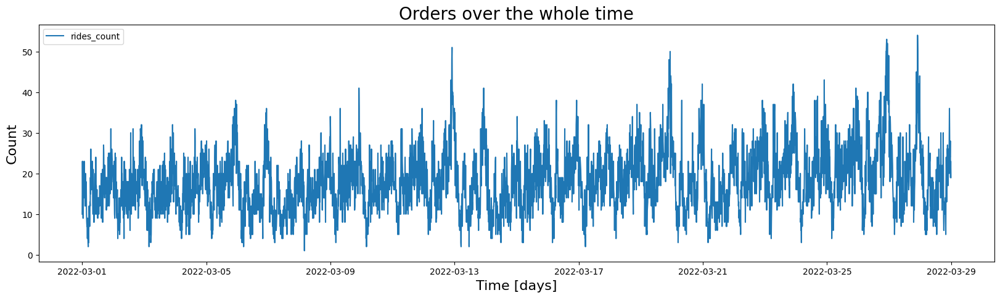

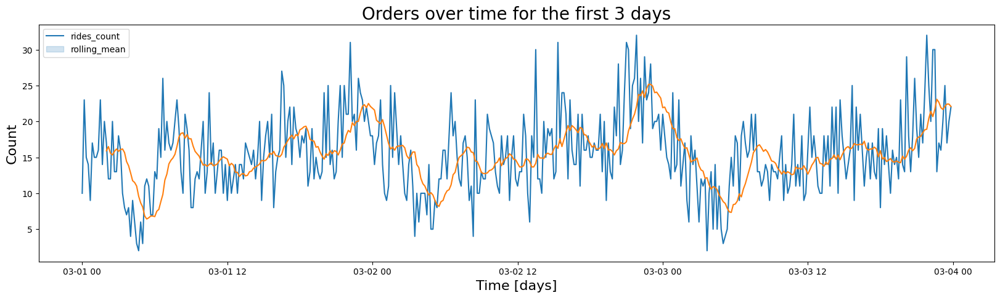

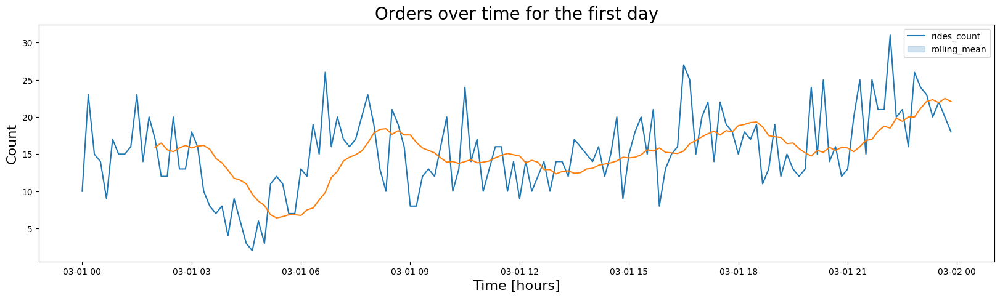

In [92]:
plt.figure(figsize=(20,5))
sns.lineplot(data=cluster_16, x='time_bin', y='rides_count', legend=True)
plt.legend(labels=["rides_count"])
plt.title('Orders over the whole time', size=20)
plt.ylabel('Count', size=16)
plt.xlabel('Time [days]', size=16)

# plot partial data for only first 3 days
plt.figure(figsize=(20,5))
sns.lineplot(data=cluster_16.iloc[:432], x=cluster_16['time_bin'][:432], y='rides_count', legend=True)
sns.lineplot(data=cluster_16.iloc[:432], x=cluster_16['time_bin'][:432], y='rolling_mean', legend=True)
plt.legend(labels=["rides_count","rolling_mean"])
plt.title('Orders over time for the first 3 days', size=20)
plt.ylabel('Count', size=16)
plt.xlabel('Time [days]', size=16)

# plot partial data for only the first day
plt.figure(figsize=(20,5))
sns.lineplot(data=cluster_16.iloc[:144], x=cluster_16['time_bin'][:144], y='rides_count', legend=True)
sns.lineplot(data=cluster_16.iloc[:144], x=cluster_16['time_bin'][:144], y='rolling_mean', legend=True)
plt.legend(labels=["rides_count","rolling_mean"])
plt.title('Orders over time for the first day', size=20)
plt.ylabel('Count', size=16)
plt.xlabel('Time [hours]', size=16)

plt.show()

### Transform the time_bin column to leave only the minutes time part, and reset the index

In [93]:
full_df = full_df.reset_index()

In [94]:
# Extract just the time part and create a new column
full_df['time_bin'] = full_df['time_bin'].dt.minute.astype('int8')


In [95]:
full_df.head()

,cluster,time_bin,rides_count,hour,day_of_month,day_of_week,is_weekend,is_holiday,weather_condition,temp,...,lag_10,lag_11,lag_12,lag_13,lag_14,lag_15,lag_16,lag_17,lag_18,rolling_mean
0,0,0,5,0,1,2,0,0,1,-1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0,10,8,0,1,2,0,0,1,-1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,20,2,0,1,2,0,0,1,-1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0,30,4,0,1,2,0,0,1,-1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,40,1,0,1,2,0,0,1,-1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## 4.6 Label Encoding of the categorical columns

We will not perform any Label Encoding since our features are already represented in columns with binary values (1 or 0) and other features contain values like day_of_month, where the number of day plays role in prediction.

In [96]:
full_df.columns

Index(['cluster', 'time_bin', 'rides_count', 'hour', 'day_of_month',
       'day_of_week', 'is_weekend', 'is_holiday', 'weather_condition', 'temp',
       'snow', 'prcp', 'lag_1', 'lag_2', 'lag_3', 'lag_4', 'lag_5', 'lag_6',
       'lag_7', 'lag_8', 'lag_9', 'lag_10', 'lag_11', 'lag_12', 'lag_13',
       'lag_14', 'lag_15', 'lag_16', 'lag_17', 'lag_18', 'rolling_mean'],
      dtype='object')

### Intermediate conclusion:

1. Several helper function for the ML part were created.
2. The data was clusterised since no ther information except of the sttlement name was possible to found.
3. The data was split into the 10-minutes time bins to predict the demand.
4. Lags and rolling mean were added.
5. No label encoding is needed in our case.


# Task 5: the ML part

This task is a regression problem. 

For our research we will use Gradient-Boosted Decision Trees (GBDT), and XGBoost (eXtreme Gradient Boosting) models together with MAE (mean absolute error), metric since it has shown good results for the similar task, according to [this article](https://arxiv.org/pdf/2109.03433.pdf). Random Forest Regressor will also be used since it often gives decent results from my experience. Additionally, we will also use Linear Regression as one of the most simples approaches, and LSTM (Long Short Term Memory), according to [this article](https://sanjayc.medium.com/manhattan-taxi-demand-prediction-f16880d00fde)

Other interesting articles:
[1](https://medium.com/analytics-vidhya/taxi-demand-prediction-on-time-series-data-with-holt-winter-forecasting-loss-0-02-2bcdeec48499)
[2](https://medium.com/salesforce-engineering/predicting-taxi-demand-with-salesforce-open-source-7370394e521e)

### Split the data

In [97]:
X_train, y_train, X_test, y_test = data_splitter(full_df)

X_train: 57212 (80.0%)
y_train: 57212 (80.0%)

X_test: 14303 (20.0%)
y_test: 14303 (20.0%)


### Resolve an issue with the NaN values for some models

In [98]:
# Initialize the imputer
imputer = SimpleImputer(strategy='mean') 

# Impute missing values in training data
X_train_imputed = imputer.fit_transform(X_train)

# Impute missing values in test data
X_test_imputed = imputer.transform(X_test)

## 5.1 Baseline Model

Let's take an average taxi order count per zone and time-bin as our baseline model. This will help us later to check the sanity of other models that we have trained.

In [99]:
baseline_model = full_df.groupby(['cluster', 'time_bin', 'hour'])['rides_count'].mean().round(1)

baseline_model = baseline_model.reset_index()
baseline_model.rename(columns={'rides_count': 'average_rides'}, inplace=True)
baseline_model = baseline_model[['cluster', 'hour', 'time_bin', 'average_rides']]

In [100]:
baseline_model.head()

,cluster,hour,time_bin,average_rides
0,0,0,0,4.5
1,0,1,0,3.7
2,0,2,0,2.9
3,0,3,0,2.6
4,0,4,0,2.8


### Baseline model predictions

In [101]:
%%time
base_y_pred = basemodel_predict(baseline_model, X_test)
print(base_y_pred)

[ 9  2  5 ...  4 13  2]
CPU times: user 2.98 s, sys: 2.17 ms, total: 2.98 s
Wall time: 3 s


### Get metrics and plot Actual vs Predicted value

MODEL: Baseline Model
MAE: 2.32


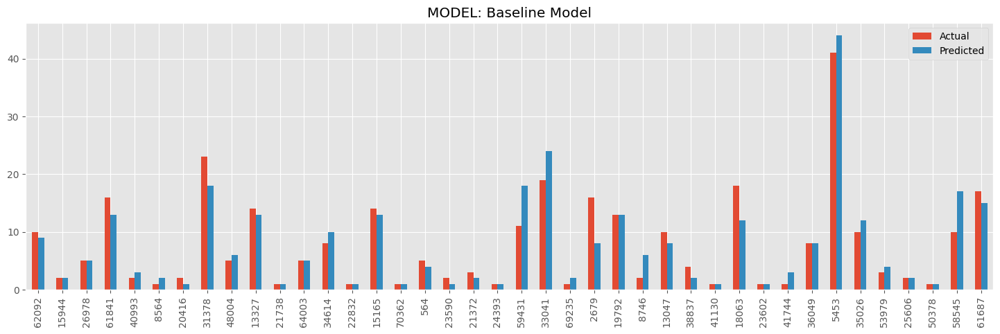

In [102]:
base_metrics = get_metrics('Baseline Model',y_test, base_y_pred)

plot_real_vs_pred('Baseline Model', y_test, base_y_pred)

### Baseline model conclusion:
It allows us to predict demand with a pretty small error of MAE = 2.3
The baseline model proves to be quite effective, suggesting that using historical averages as a predictor for future demand is a valid approach in this context. However, while the model is clearly effective, the presence of some errors indicated by the MAE values suggests that there might be room for improvement.

## 5.2 Linear Regressor model

In [103]:
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer

In [104]:

# Create a pipeline that includes imputation, optional scaling, and the regression model
pipeline = Pipeline([
    ('imputer', SimpleImputer(strategy='mean')),  # Impute missing values
    ('scaler', StandardScaler()),  # Optional: Scale features
    ('regressor', LinearRegression())  # Linear regression model
])

In [105]:
%time
# Use the pipeline to fit the model on the training data
pipeline.fit(X_train, y_train)

# Use the pipeline to predict on the test data
lin_reg_y_pred = pipeline.predict(X_test)


CPU times: user 1 µs, sys: 1e+03 ns, total: 2 µs
Wall time: 2.86 µs


MODEL: Linear Regression
MAE: 2.42


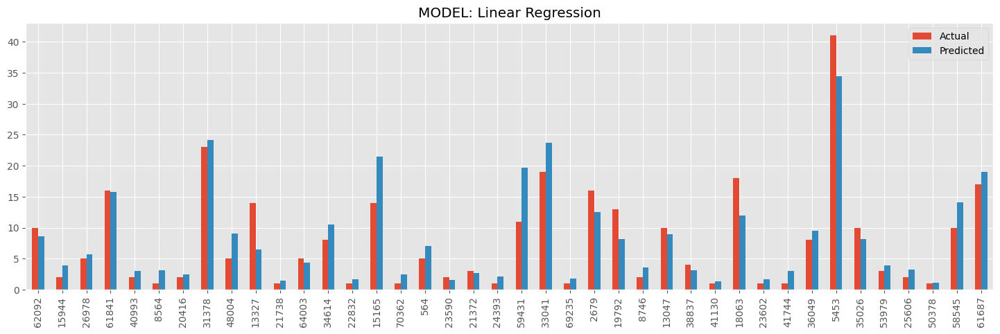

In [106]:
linear_metrics = get_metrics('Linear Regression',y_test, lin_reg_y_pred)

plot_real_vs_pred('Linear Regression', y_test, lin_reg_y_pred)

## 5.3 Histogram-based Gradient Boosting Regression Tree

In [107]:
# Initialize variables to track the best model and metrics
# Create dataframe to write down the results
hgbrt_result_df = pd.DataFrame(columns=['learning_rate', 'depth', 'MAE'])

best_model_hgbrt = None
best_score = float('inf')
best_params = {}

learning_rates = [0.05, 0.1, 0.3]
max_depths = range(1, 15, 1)

# Explore the parameter grid
for rate in learning_rates:
    for depth in max_depths:
        model = HistGradientBoostingRegressor(learning_rate=rate, max_depth=depth, random_state=42)
        
        # Use cross-validation to evaluate model
        scores = cross_val_score(model, X_train, y_train, cv=5, scoring='neg_mean_absolute_error')
        mean_MAE = -np.mean(scores)  # Convert negative MAE scores to positive

        # Update the results DataFrame
        new_row = {'learning_rate': rate, 'depth': depth, 'MAE': round(mean_MAE, 2)}
        hgbrt_result_df = pd.concat([hgbrt_result_df, pd.DataFrame([new_row])], ignore_index=True)
        
        
        # Update the best model if the current MAE is lower
        if mean_MAE < best_score:
            best_model_hgbrt = model
            best_score = mean_MAE
            best_params = {'learning_rate': rate, 'depth': depth}

# Fit the best model
best_model_hgbrt.fit(X_train, y_train)

# Print best model parameters
print(f"Best Model Parameters: {best_params}")
print()

# Get predictions of the best model
hbrt_y_pred = best_model_hgbrt.predict(X_test)

# Evaluate the best model
metrics_hgbrt = get_metrics('HGB Regression Tree', y_test, hbrt_y_pred)

Best Model Parameters: {'learning_rate': 0.1, 'depth': 8}

MODEL: HGB Regression Tree
MAE: 2.24


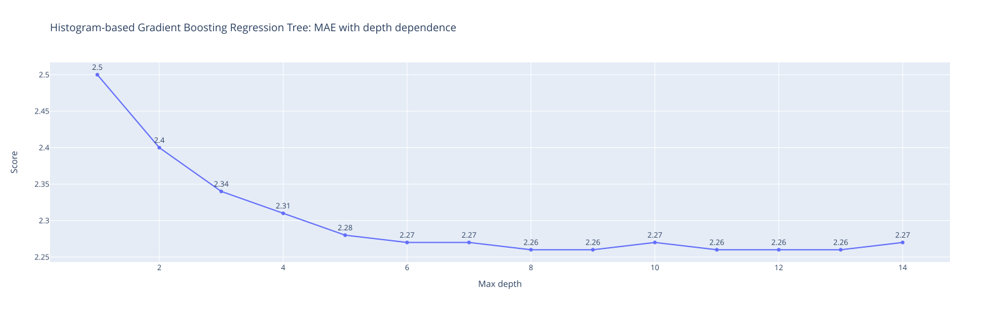

In [108]:
# Filter only for the best learning_rate
hgbrt_result_df = hgbrt_result_df[hgbrt_result_df['learning_rate']==0.1]

fig = px.line(hgbrt_result_df, x='depth', y='MAE', markers=True,
              title='Histogram-based Gradient Boosting Regression Tree: MAE with depth dependence', text='MAE')
fig.update_layout(xaxis_title="Max depth", yaxis_title="Score")
fig.update_traces(textposition='top center')
fig.show(renderer="svg", width = 1600, height = 500)

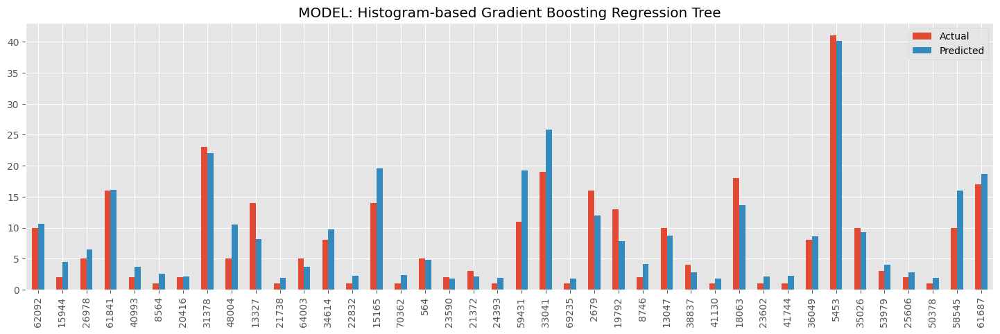

In [109]:
model_name = 'Histogram-based Gradient Boosting Regression Tree'

# Get predictions of the best model
hgbrt_y_pred = best_model_hgbrt.predict(X_test)

plot_real_vs_pred(model_name, y_test, hgbrt_y_pred)

## 5.4 Random Forest Regressor

In [110]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.impute import SimpleImputer
from sklearn.model_selection import cross_val_score
import numpy as np
import pandas as pd

# Create dataframe to record the results
rf_result_df = pd.DataFrame(columns=['n_estimators', 'MAE', 'max_depth'])

# Initialize variables to track the best model and metrics
best_model_rf = None
best_score = float('inf')
best_params = {}

# Parameter grid
n_estimators_range = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 150]  # Number of trees in the forest
max_depths = range(15, 21, 5)  # Optimal depth levels found to be effective

# Explore the parameter grid
for n_estimators in n_estimators_range:
    for depth in max_depths:
        model = RandomForestRegressor(n_estimators=n_estimators, max_depth=depth, random_state=42, n_jobs=-1)
        
        # Perform cross-validation and calculate MAE
        scores = cross_val_score(model, X_train_imputed, y_train, cv=5, scoring='neg_mean_absolute_error')
        mean_MAE = -np.mean(scores)  # Convert from negative to positive MAE
        
        # Update the results DataFrame
        new_row = {'max_depth': depth,'n_estimators': n_estimators, 'MAE': round(mean_MAE, 2)}
        rf_result_df = pd.concat([rf_result_df, pd.DataFrame([new_row])], ignore_index=True)
        
        # Update the best model if the current MAE is lower
        if mean_MAE < best_score:
            best_model_rf = model
            best_score = mean_MAE
            best_params = {'n_estimators': n_estimators, 'max_depth': depth}

# Fit the best model on the entire dataset
best_model_rf.fit(X_train_imputed, y_train)

# Print best model parameters
print(f"Best Model Parameters: {best_params}")
print()

# Get predictions of the best model
rf_y_pred = best_model_rf.predict(X_test_imputed)

# Evaluate the best model
metrics_rf = get_metrics('Random Forest Regressor', y_test, rf_y_pred)

Best Model Parameters: {'n_estimators': 150, 'max_depth': 15}

MODEL: Random Forest Regressor
MAE: 2.29


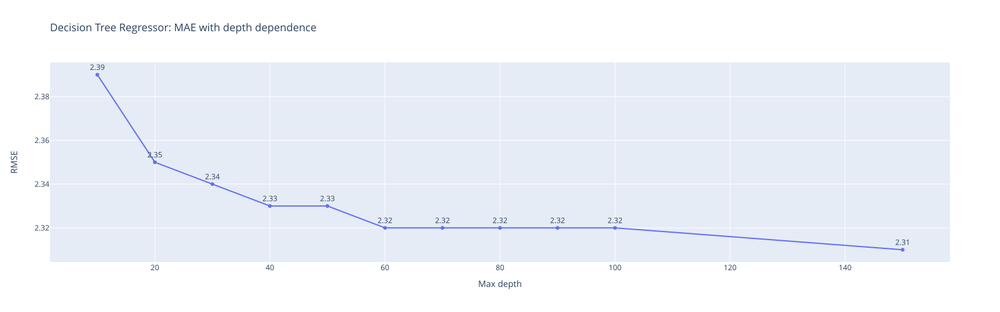

In [111]:
# Filter only for the best max_depth
rf_result_df = rf_result_df[rf_result_df['max_depth']==15]

fig = px.line(rf_result_df, x='n_estimators', y='MAE', markers=True,
              title='Decision Tree Regressor: MAE with depth dependence', text='MAE')
fig.update_layout(xaxis_title="Max depth", yaxis_title="RMSE")
fig.update_traces(textposition='top center')
fig.show(renderer="svg", width = 1600, height = 500)

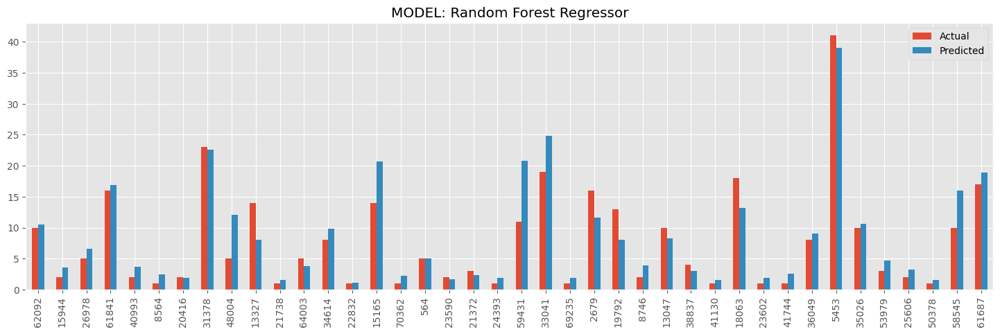

In [112]:
model_name = 'Random Forest Regressor'

# Get predictions of the best model
rf_y_pred = best_model_rf.predict(X_test_imputed)

plot_real_vs_pred(model_name, y_test, rf_y_pred)

## 5.5 XGBoost (eXtreme Gradient Boosting)

In [113]:
# Create dataframe to write down the results
xgb_result_df = pd.DataFrame(columns=['n_estimators', 'learning_rate', 'MAE'])

# Initialize variables to track the best model and metrics
best_model_xgb = None
best_score = float('inf')
best_params = {}

# Parameter grid
n_estimators_range = [10, 20, 30, 40, 50, 100, 150, 200]  # Number of boosting rounds
learning_rates = [0.01, 0.05, 0.1, 0.2, 0.3]  # Learning rate or eta

# Explore the parameter grid
for n_estimators in n_estimators_range:
    for learning_rate in learning_rates:
        model = XGBRegressor(n_estimators=n_estimators, learning_rate=learning_rate, random_state=42, n_jobs=-1)
        
        # Perform cross-validation and calculate MAE
        scores = cross_val_score(model, X_train, y_train, cv=5, scoring='neg_mean_absolute_error')
        mean_MAE = -np.mean(scores)  # Convert from negative to positive MAE
        
        # Update the results DataFrame
        new_row = {'n_estimators': n_estimators, 'learning_rate': learning_rate, 'MAE': round(mean_MAE, 2)}
        xgb_result_df = pd.concat([xgb_result_df, pd.DataFrame([new_row])], ignore_index=True)
        
        # Update the best model if the current MAE is lower
        if mean_MAE < best_score:
            best_model_xgb = model
            best_score = mean_MAE
            best_params = {'n_estimators': n_estimators, 'learning_rate': learning_rate}

# Fit the best model
best_model_xgb.fit(X_train, y_train)

# Optionally print or visualize all results
print(f"Best Model Parameters: {best_params}")

# Get predictions of the best model
xgb_y_pred = best_model_xgb.predict(X_test_imputed)

# Evaluate the best model
metrics_xgb = get_metrics('XGBoost', y_test, xgb_y_pred)

Best Model Parameters: {'n_estimators': 200, 'learning_rate': 0.1}
MODEL: XGBoost
MAE: 2.22


In [114]:
X_train

,cluster,time_bin,hour,day_of_month,day_of_week,is_weekend,is_holiday,weather_condition,temp,snow,...,lag_10,lag_11,lag_12,lag_13,lag_14,lag_15,lag_16,lag_17,lag_18,rolling_mean
65806,17,10,21,26,6,1,0,1,0,0,...,10.0,1.0,3.0,6.0,5.0,7.0,2.0,7.0,7.0,5.583333
11495,2,20,23,25,5,0,0,1,5,0,...,4.0,6.0,14.0,9.0,8.0,3.0,9.0,8.0,10.0,6.583333
29496,8,0,16,3,4,0,0,1,1,0,...,21.0,14.0,15.0,7.0,26.0,13.0,10.0,6.0,17.0,16.833334
15177,3,30,19,23,3,0,0,1,0,0,...,19.0,15.0,14.0,26.0,17.0,16.0,15.0,27.0,23.0,15.750000
31267,8,20,23,15,2,0,0,1,1,0,...,15.0,12.0,13.0,17.0,13.0,12.0,19.0,11.0,8.0,16.583334
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37194,10,30,12,1,2,0,0,1,6,0,...,8.0,7.0,11.0,11.0,8.0,9.0,5.0,11.0,11.0,8.166667
6265,1,0,23,16,3,0,0,1,1,0,...,42.0,51.0,59.0,45.0,40.0,36.0,38.0,46.0,55.0,52.250000
54886,14,10,21,27,7,1,0,0,0,0,...,1.0,3.0,1.0,2.0,3.0,4.0,5.0,3.0,7.0,4.250000
860,0,0,3,7,1,0,0,1,0,0,...,4.0,4.0,3.0,3.0,6.0,3.0,5.0,6.0,5.0,2.833333


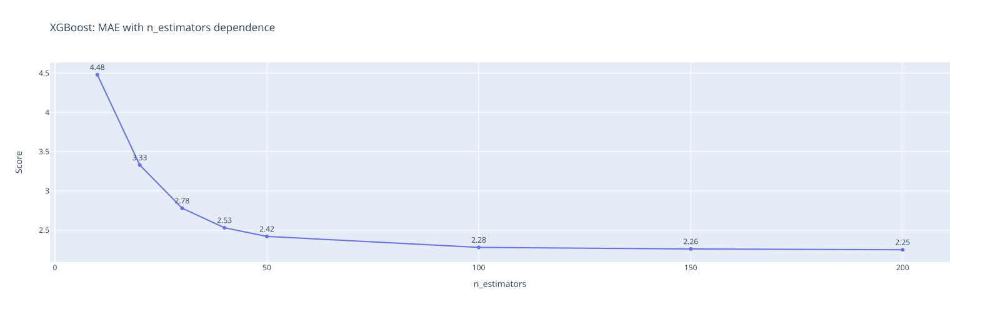

In [115]:
# Filter only for the best learning_rate
xgb_result_df = xgb_result_df[xgb_result_df['learning_rate']==0.05]

fig = px.line(xgb_result_df, x='n_estimators', y='MAE', markers=True,
              title='XGBoost: MAE with n_estimators dependence', text='MAE')
fig.update_layout(xaxis_title="n_estimators", yaxis_title="Score")
fig.update_traces(textposition='top center')
fig.show(renderer="svg", width = 1600, height = 500)

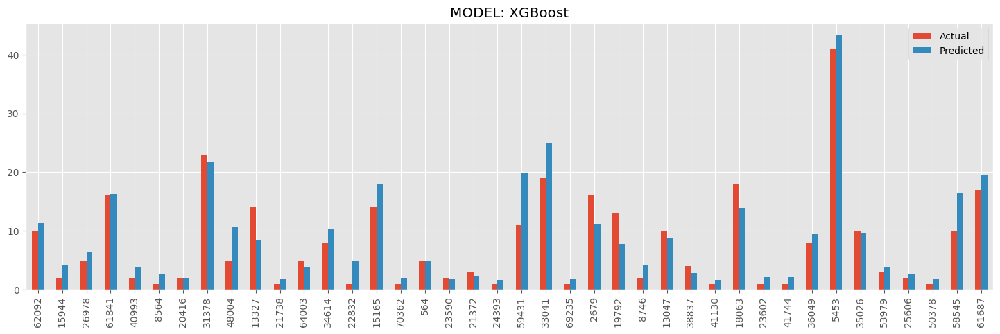

In [116]:
model_name = 'XGBoost'

plot_real_vs_pred(model_name, y_test, xgb_y_pred)

## 5.6 LSTM (Long-Short Term Memory)

In [117]:
lstm_result_df = pd.DataFrame(columns=['num_units', 'MAE'])

# Scale data to (0, 1) - often necessary for neural networks, particularly RNNs
scaler = MinMaxScaler(feature_range=(0, 1))
X_train_scaled = scaler.fit_transform(X_train_imputed)
X_test_scaled = scaler.transform(X_test_imputed)

# Reshape input to be [samples, time steps, features] which is required for LSTM
X_train_scaled = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_scaled = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Initialize variables to track the best model and metrics
best_model_lstm = None
best_params = {}
best_score = float('inf')

# Parameter grid
unit_options = [10, 50, 100, 150, 200, 250]  # Number of LSTM units in each layer

# Explore the parameter grid
for units in unit_options:
    model = Sequential([
        Input(shape=(1, X_train_scaled.shape[2])),  # Define the input shape explicitly here
        LSTM(units),
        Dense(1)
    ])
    model.compile(loss='mean_squared_error', optimizer='adam')

    model.fit(X_train_scaled, y_train, epochs=50, batch_size=32, verbose=0)  # Fit model
    y_pred = model.predict(X_test_scaled)  # Predict on test set

    # Get metrics without printing them
    _, MAE = get_metrics('LSTM', y_test, y_pred.flatten(), to_print=False)

    # Update the results DataFrame
    new_row = {'num_units': units, 'MAE': round(MAE, 2)}
    lstm_result_df = pd.concat([lstm_result_df, pd.DataFrame([new_row])], ignore_index=True)

    # Update the best model if the current score is lower
    if MAE < best_score:
        best_model_lstm = model
        best_score = MAE
        best_params = {'num_units': units}

# Print best model parameters
print(f"Best Model Parameters: {best_params}")
print()

# Evaluate the best model on test data again for final metrics
metrics_lstm = get_metrics('LSTM Regression', y_test, y_pred.flatten())
print(f"Metrics: {metrics_lstm}")

447/447 ━━━━━━━━━━━━━━━━━━━━ 0s 414us/step
447/447 ━━━━━━━━━━━━━━━━━━━━ 0s 421us/step
447/447 ━━━━━━━━━━━━━━━━━━━━ 0s 557us/step
447/447 ━━━━━━━━━━━━━━━━━━━━ 0s 542us/step
447/447 ━━━━━━━━━━━━━━━━━━━━ 0s 589us/step
447/447 ━━━━━━━━━━━━━━━━━━━━ 0s 603us/step
Best Model Parameters: {'num_units': 50}

MODEL: LSTM Regression
MAE: 2.34
Metrics: ('LSTM Regression', 2.3437654677814166)


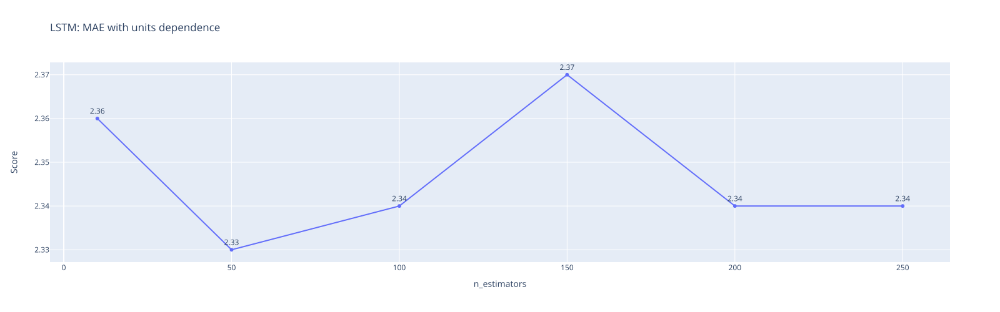

In [118]:
fig = px.line(lstm_result_df, x='num_units', y='MAE', markers=True,
              title='LSTM: MAE with units dependence', text='MAE')
fig.update_layout(xaxis_title="n_estimators", yaxis_title="Score")
fig.update_traces(textposition='top center')
fig.show(renderer="svg", width = 1600, height = 500)

## 5.7 Compare models' metrics

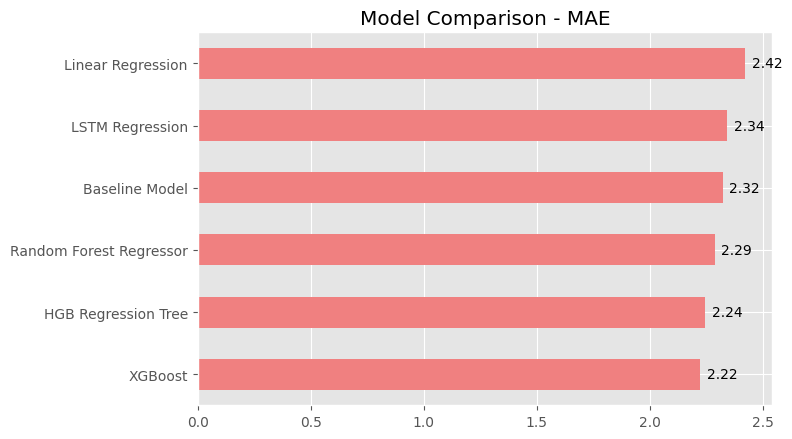

In [119]:
compare_model_metrics([base_metrics, linear_metrics, metrics_hgbrt, metrics_rf, metrics_xgb, metrics_lstm])

## 5.8 Relative importance of the features for the best model

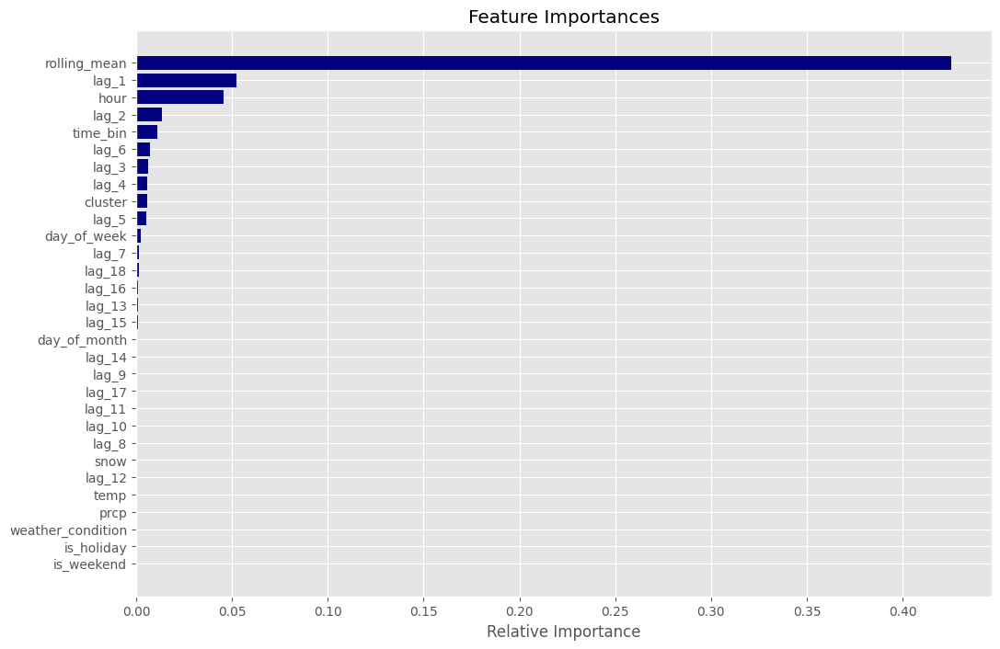

In [120]:
from sklearn.inspection import permutation_importance
import matplotlib.pyplot as plt
import numpy as np

# Assuming 'best_model_hgbrt' is your trained HistGradientBoostingRegressor model
# and 'X_test', 'y_test' are your testing datasets

result = permutation_importance(best_model_hgbrt, X_test, y_test, n_repeats=10, random_state=42, n_jobs=-1)

# Extract feature importances and their indices
importances = result.importances_mean
indices = np.argsort(importances)

# Get feature names sorted by importance
features = X_test.columns.tolist()
sorted_features = [features[i] for i in indices]

plt.figure(figsize=(12, 8))
plt.title('Feature Importances')
plt.barh(range(len(indices)), importances[indices], color='navy', align='center')
plt.yticks(range(len(indices)), sorted_features)
plt.xlabel('Relative Importance')
plt.show()


# Step 6: Final Conclusion

1. Initially, the data had some outliers and inefficient data types that were cleaned and optimized. The deleted data comprises aroun 0.2% of the entire dataset and the dataset memory consumption was also reduced by around 50%.
2. Exploratory Data Analysis (EDA) was performed to analyze the data and identify patterns, such as starting and ending points of trips, rush times in Tallinn and its suburbs, and the busiest days for taxi demand.
3. Several additional features were incorporated into the datasets, including locations, clusters, and weather conditions.
4. The data was prepared for the machine learning phase.
5. Several models were selected for predicting taxi demand with some basic hyperparameter tuning:
    * Basemodel (based on average trips per day per cluster), which showed very decent results, likely because the data was synthetic.
    * Linear Regression model.
    * Random Forest Regressor.
    * HGB Regression Tree (Histogram-based Gradient Boosting Regression Tree), which is much faster than GradientBoostingRegressor for big datasets (n_samples >= 10,000) and has native support for missing values (NaNs).
    * XGBoost (eXtreme Gradient Boosting), well-suited for large datasets and high-dimensional feature spaces, with built-in handling of missing data and features for regularization to prevent overfitting. It is effective for both regression and classification tasks.
    * LSTM (Long Short-Term Memory) Deep Learning Model, which is the default choice for sequences of data, whether text or time-series, according to scientific articles.
6. MAE (Mean Average Error) was chosen as the main metric for its ease of interpretation. Cross-validation was also performed for better model fitting.
7. Among the models tested, the HGB Regression Tree showed the best results. Although its MAE was not much lower compared to the Baseline model (2.24 vs 2.32), even small differences can save significant amounts for a large company. Better results might be achieved with non-synthetic data or over a longer timeframe.
8. The three most important features for predicting demand are:
    * rolling_mean
    * lag_1
    * hour

### What could be further improved:
1. With access to a location API, the city could be segmented into areas such as zip codes or even streets to better predict demand.
2. Airport data could also be included as it would likely impact demand in certain locations. Historic data from Tallinn Airport was not available.
3. More intensive hyperparameter tuning using GPUs could enable the training of even better models.
4. Additional metrics such as RMSE and MAPE, which were main metrics in [this article](https://www.sciencedirect.com/science/article/pii/S0968090X20305805), could provide deeper insights into the performance of our models.
5, GridSearchCV could also be used to streamline the search for better parameters.

# Step 7: the next steps

### Model design and deployment

Combining SageMaker and Airflow, one can automate much of the manual work involved in machine learning projects, ensure models are kept up-to-date with the latest data, and maintain high levels of accuracy and performance in your taxi-demand prediction application. For deployment, the model could be integrated into a cloud-based application using platforms such as AWS. APIs could beused for real-time data fetching and prediction output. The model would be updated periodically with new data, and continuous monitoring would be set up to track performance and trigger retraining if the model's accuracy degrades.

### Communication of Model recommendations to drivers

For effective communicating of model's recommendations to drivers it could be integrated into an Bolt-app to display predictions in an easy-to-understand format (e.g. real-time demand heat maps), suggesting areas with high demand potential, and possible fare estimates to encourage drivers to move toward these demand areas. Notifications or alerts could be sent to drivers about sudden changes in demand due to events or weather changes in a user-friendly format, displaying information graphically, such as through color-coded areas on maps and simple text alerts.

### Design of the Experiment to validate the Model
To validate the effectiveness of the taxi-demand prediction model in live operations, I would propose a controlled experiment with two groups of drivers: one using the model's recommendations (treatment group) and the other using traditional methods (control group).

The experiment would run over a significant period to cover different times and conditions, such as weekdays, weekends, holidays, different weather conditions, and special events. Key performance indicators (KPIs) such as the number of rides, idle time, earnings per hour, and driver satisfaction would be measured across both groups.

Data collected during this period would be analyzed to assess the impact of the model's recommendations. A/B testing would be employed to determine if there are significant differences in the KPIs between the two groups. Feedback from drivers regarding the usability and helpfulness of the predictions would also be collected to further refine the model and its deployment.